In [1]:
#%matplotlib notebook
%matplotlib inline
import bz2, os, time
from os import path
import numpy as np
from matplotlib import pyplot as plt
from scipy import stats, interpolate
from scipy.optimize import curve_fit
import matplotlib.dates as mdate
import pandas as pd
import seaborn as sns
from pathlib import Path
from PIL import Image
from IPython.display import display
#from my_funcs import getfiles, natural_sort_key, cumsum_sma

sns.set_context("talk")

PLOT_DIR = Path("./plots")
PLOT_DIR.mkdir(exist_ok=True)

DATA_DIR = Path("./data/Oszi/step3/")
DATA_DIR.mkdir(exist_ok=True)

B1500A_DIR = Path("./data/B1500A/step1/")
#B1500A_DIR.mkdir(exist_ok=True)

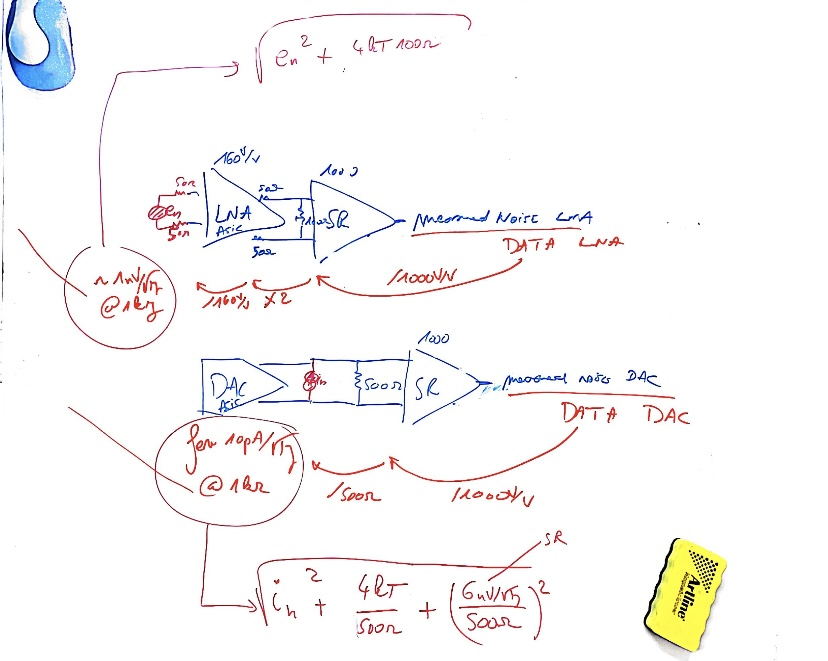

In [2]:
img = Image.open('img/IMG_5794.jpg')
display(img)

* Output data at LNA has been multiplied by 160 times by LNA, then divide by 2 by resistance , multiplied to 1000 by SR. Then to calculate the input noise, we follow the equation
  $$ n_i = \frac{2 \cdot n_{out}}{1000 \cdot 160} = \frac{n_{out}}{80000} $$
  In fact, the noise is the combination of voltage noise $e_n^2$ and thermal noise of resistance, then
  $$ n_i = \sqrt{e_n^2 + 4kT100} = \frac{n_{out}}{80000} \Rightarrow e_n = \sqrt{\frac{n_{out}^2}{80000^2} - 4kT100}  [V/\sqrt{Hz}]$$
  (T is the temperature at room temperature ($300 [K]$), k is the Boltzman constant $1.38e-23 [J/K] $)

* Output data at DAC has been multiplied by $500 \Omega$ resistance to convert from current to voltage, then multiplied by 1000 by SR.To calculate the input noise, we follow the equation
  $$ n_i = \frac{n_{out}}{1000*500} = \frac{n_{out}}{500000} $$
  In fact, the noise is the combination of current noise $i_n^2$ and thermal noise of resistance, then the noise from SR.
  $$ n_i = \sqrt{i_n^2 + \frac{4kT}{500} + (\frac{6e-9}{500})} \Rightarrow i_n = \sqrt{\frac{n_{out}^2}{500000^2} - \frac{4kT}{500} - \frac{6}{500e9}} $$

In [3]:
DATA_DIR = './data/Oszi/'

In [4]:
def dat_conv(data, type):
    k = 1.38e-23
    T = 300
    noise = []
    
    if type == 'LNA':
        #noise = [np.sqrt(a**2/80000**2 - 4*k*T*100) for a in data]
        noise = [a/80000 for a in data]
    elif type == 'DAC':
        #noise = [np.sqrt(dat**2/500000**2 - 4*k*T/500 - 6/500e9) for dat in data]
        noise = [(dat/500000) for dat in data]
    
    return noise

def sort_data(DATA_DIR, step, number, type, f):
    DATA_DIR = DATA_DIR + step + '/'
    DATA_DIR = Path(DATA_DIR)
    
    file_name = [f for f in os.listdir(DATA_DIR) if f.endswith('.TXT')]
    #print('done')
    # number: from 1 to  7 (number the board we use)
    # type: '['D'] for DAC, ['L'] for LNA, or ['D','L'] for both
    #f: ['L'] for low frequency, ['H'] for high frequency, ['L','H'] for both
    
    # DATA_path = 
    #Sort the name of file we want
    name_var = []
    for name in file_name:
        if name and name[2] in type and int(name[1]) in number and name[3] in f:
                name_var.append(name)
                #sort it by number
    name_var = sorted(name_var, key=lambda x: int(x[1]))
    #print(name_var)
    f_noise = []
    noise_val = []
    for i in range(len(name_var)):
        # Construct the full file path
        file_path = os.path.join(DATA_DIR, name_var[i])
        
        # Load the data from the file
        f_data, data = np.loadtxt(file_path, unpack=True, encoding='utf-8')
        f_noise.append(f_data)
        if name_var[i][2] == 'L':
            noise_val.append(dat_conv(data, 'LNA'))
        elif name_var[i][2] == 'D':
            noise_val.append(dat_conv(data, 'DAC'))
    print(f'There are {len(name_var)} files in the sorted list, they are {name_var}')
    return f_noise, noise_val, name_var

In [5]:
def plot_noise_per_step(board_number,type, F, step):
    dir_sv1 = step
    f0,val0, name0 = sort_data(DATA_DIR, step, board_number, type, F)
    
    #line_label
    f_label = []
    for i in range(len(name0)):
        if name0[i][3] == 'L':
            f_label.append('LF')
        elif name0[i][3] == 'H':
            f_label.append('HF')
    plt.figure(figsize = (15,10))
    if type[0] == 'D':
        if len(F) > 1:
            f = 'DAC_LF_HF'
        else:
            if F[0] == 'L':
                f = 'DAC_LF'
            elif F[0] == 'H':
                f = 'DAC_HF'
        # label = '$\sqrt{i_n^2 + \frac{4kT}{500} + (\frac{6nV/\sqrt{Hz}}{500})} [A/\sqrt{Hz}]$'
        plt.ylabel(r'$\sqrt{i_n^2 + \frac{4kT}{500} + (\frac{6nV/\sqrt{Hz}}{500})} [A/\sqrt{Hz}]$')
    if type[0] == 'L':
        if len(F) > 1:
            f = 'LNA_LF_HF'
        else:
            if F[0] == 'L':
                f = 'LNA_LF'
            elif F[0] == 'H':
                f = 'LNA_HF'
        # label = '$\sqrt{i_n^2 + \frac{4kT}{500} + (\frac{6nV/\sqrt{Hz}}{500})} [A/\sqrt{Hz}]$'
        plt.ylabel(r'$\sqrt{e_n^2 + 4kT100} [V/ \sqrt{Hz}] $')   

        
    name =   f'Noise_{step}_' + f'Board{board_number[0]}_' + f + '_Different Dose rate' 
    if len(board_number) > 1:
        name =   f'Noise_{step}_' + 'Board1to6_' + f + '_Different Dose rate'  
    plt.title(f'{name}')
    for i in range(len(val0)):
        step = 'step' + f'{name0[i][5]}'
        plt.plot(f0[i],val0[i],lw = 1, label = f'Board {name0[i][1]}, {f_label[i]}, {step}')
    if type[0] == 'D':
        plt.axhline(y = 10e-12, lw = 2)
    elif type[0] == 'L':
        plt.axhline(y = 1e-9, lw = 2)
    
    plt.xscale('log')
    plt.yscale('log')
    #plt.ylabel(f'{label}')
    plt.grid(which='major', linestyle='-', linewidth='0.5', color='black')
    # Customize the minor grid
    plt.grid(which='minor', linestyle=':', linewidth='0.5', color='black')
    plt.legend(loc = 'upper right')
    plt.savefig(f'plots/{dir_sv1}/{name}.png')

There are 2 files in the sorted list, they are ['B1DLF0.TXT', 'B1DHF0.TXT']
There are 2 files in the sorted list, they are ['B2DLF0.TXT', 'B2DHF0.TXT']
There are 2 files in the sorted list, they are ['B3DHF0.TXT', 'B3DLF0.TXT']
There are 2 files in the sorted list, they are ['B4DHF0.TXT', 'B4DLF0.TXT']
There are 2 files in the sorted list, they are ['B5DLF0.TXT', 'B5DHF0.TXT']
There are 2 files in the sorted list, they are ['B6DLF0.TXT', 'B6DHF0.TXT']
There are 2 files in the sorted list, they are ['B1LHF0.TXT', 'B1LLF0.TXT']
There are 2 files in the sorted list, they are ['B2LHF0.TXT', 'B2LLF0.TXT']
There are 2 files in the sorted list, they are ['B3LLF0.TXT', 'B3LHF0.TXT']
There are 2 files in the sorted list, they are ['B4LLF0.TXT', 'B4LHF0.TXT']
There are 2 files in the sorted list, they are ['B5LHF0.TXT', 'B5LLF0.TXT']
There are 2 files in the sorted list, they are ['B6LHF0.TXT', 'B6LLF0.TXT']
There are 12 files in the sorted list, they are ['B1DLF0.TXT', 'B1DHF0.TXT', 'B2DLF0.TXT

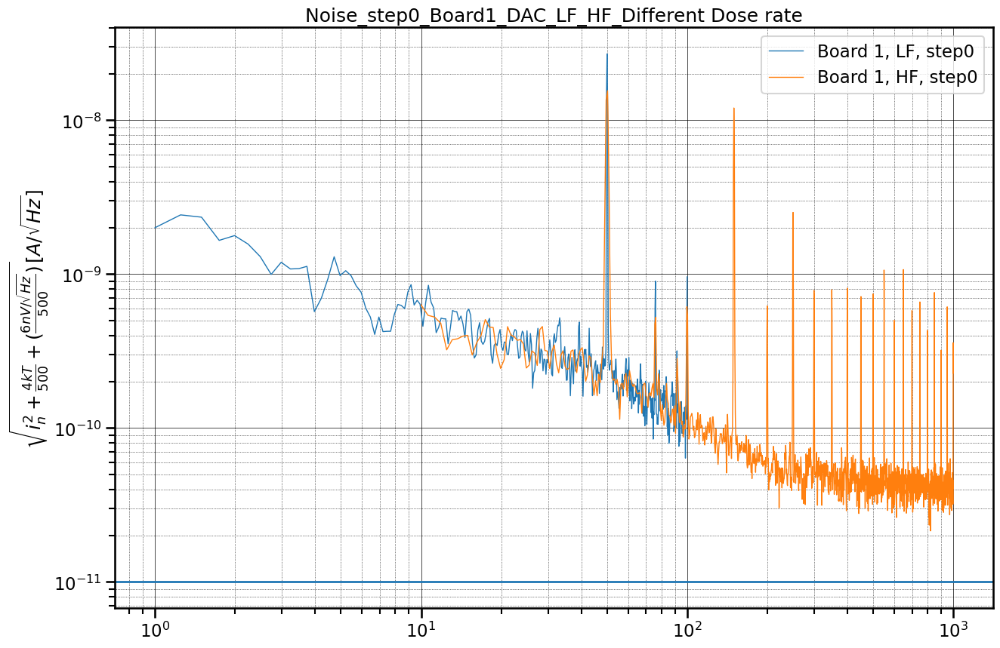

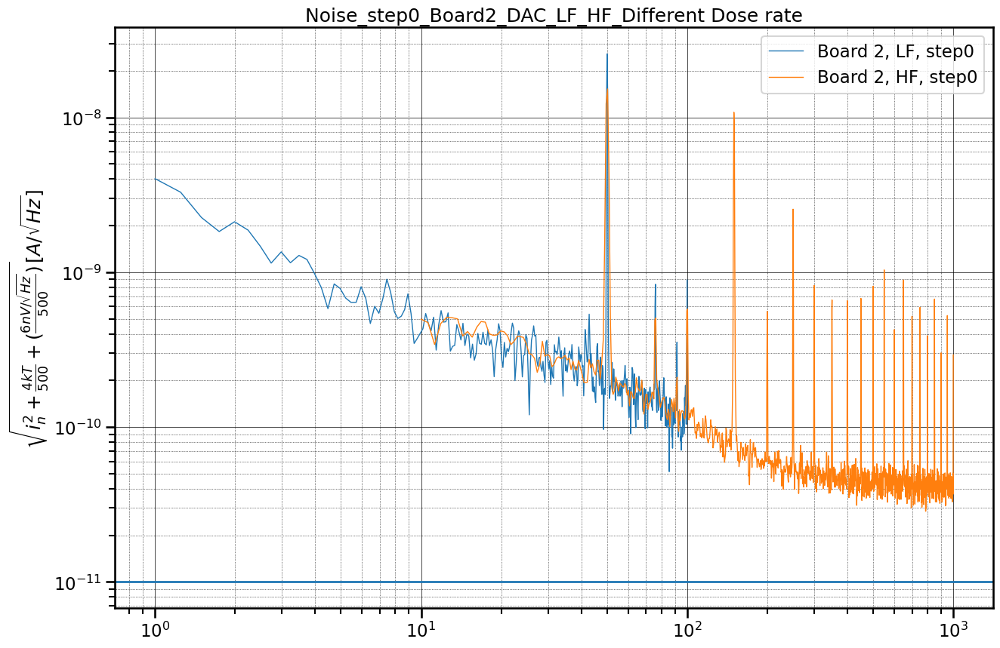

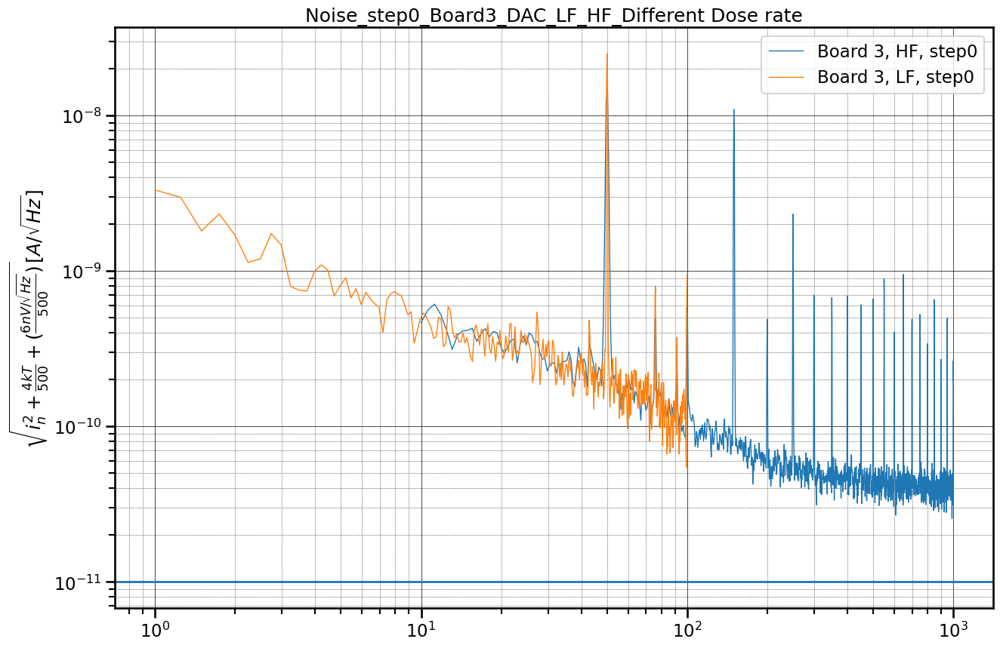

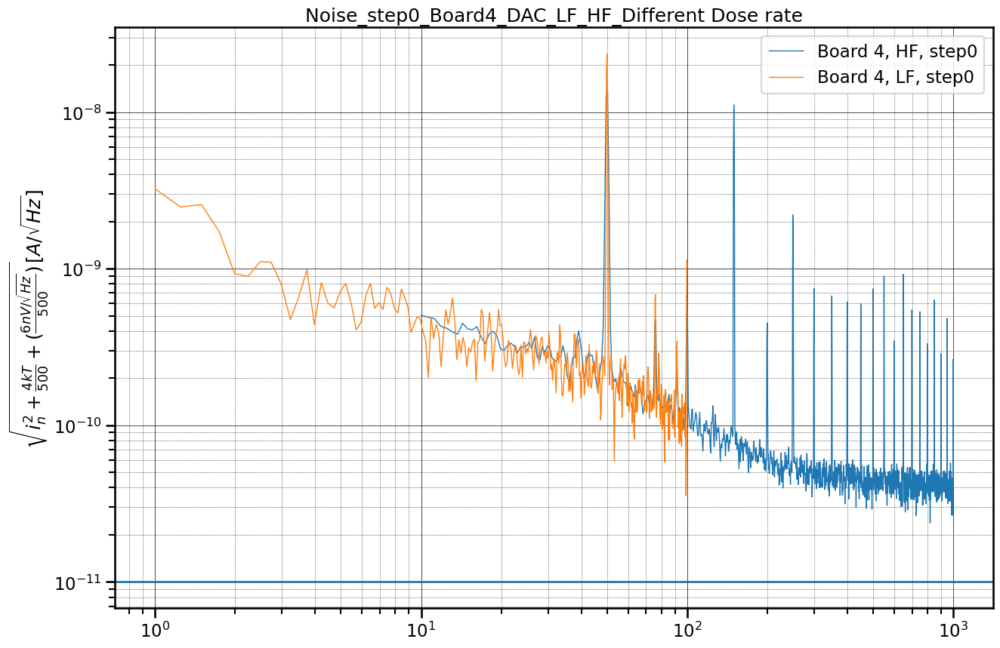

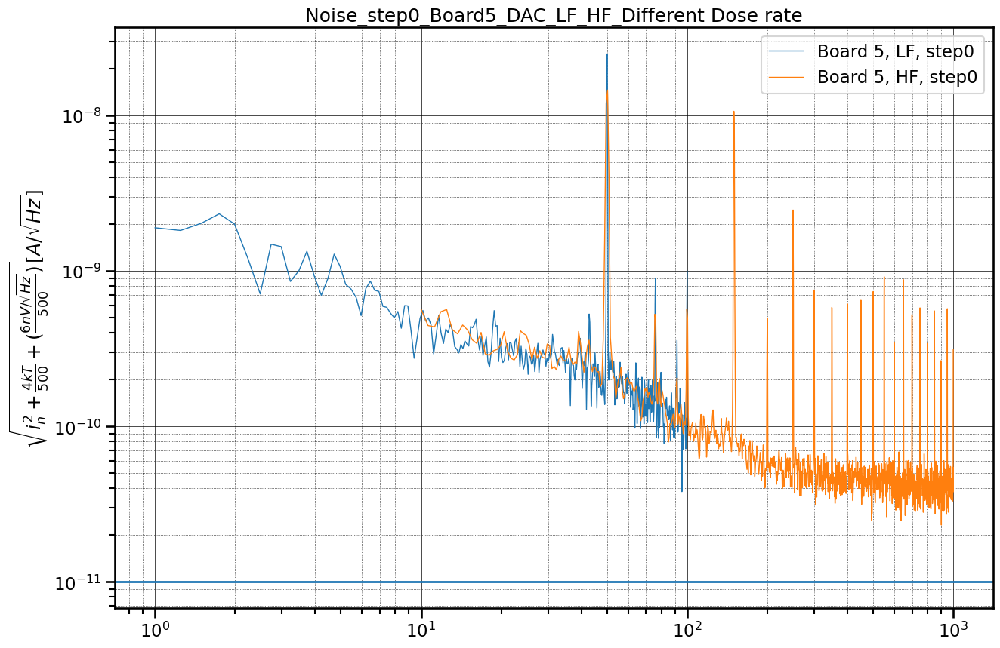

...

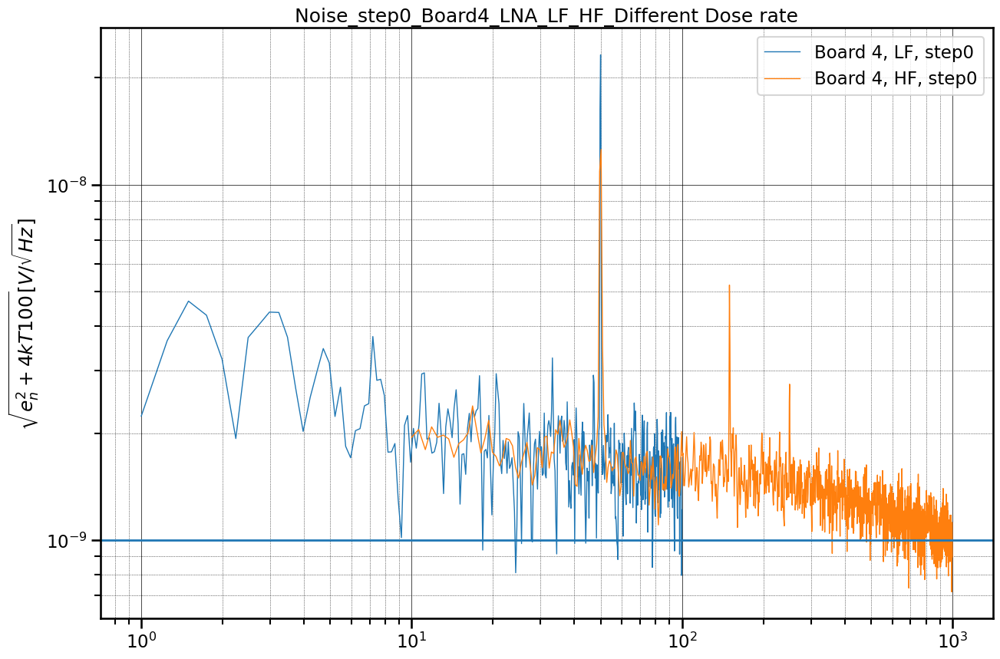

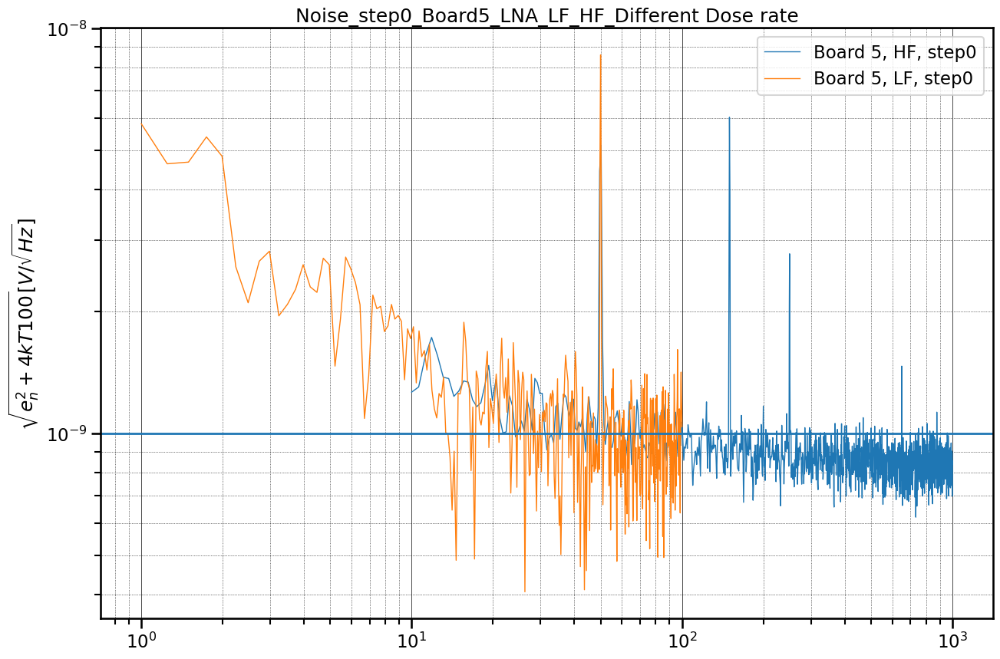

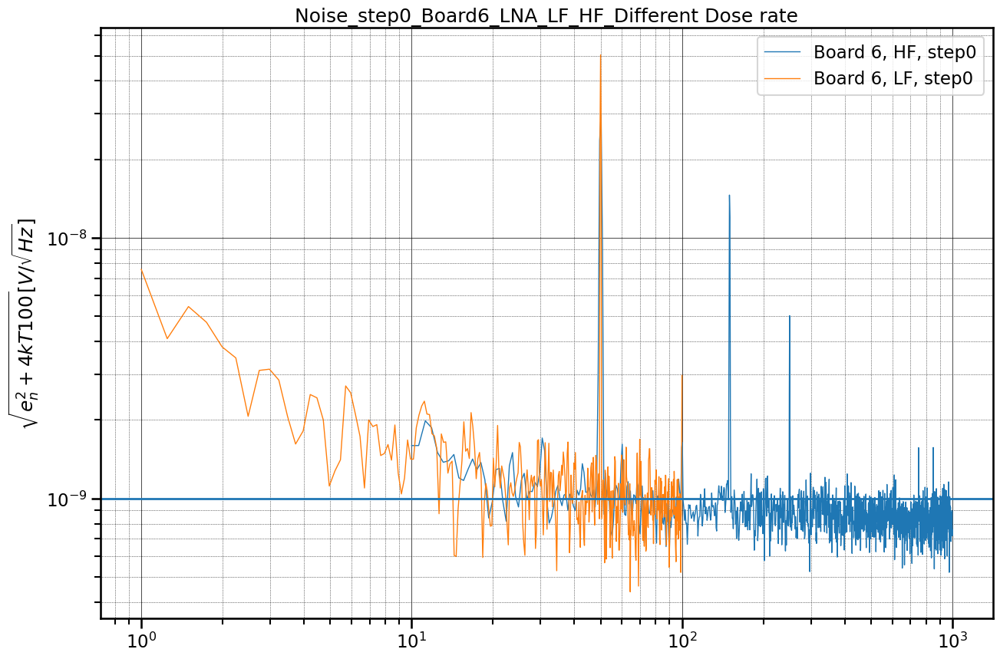

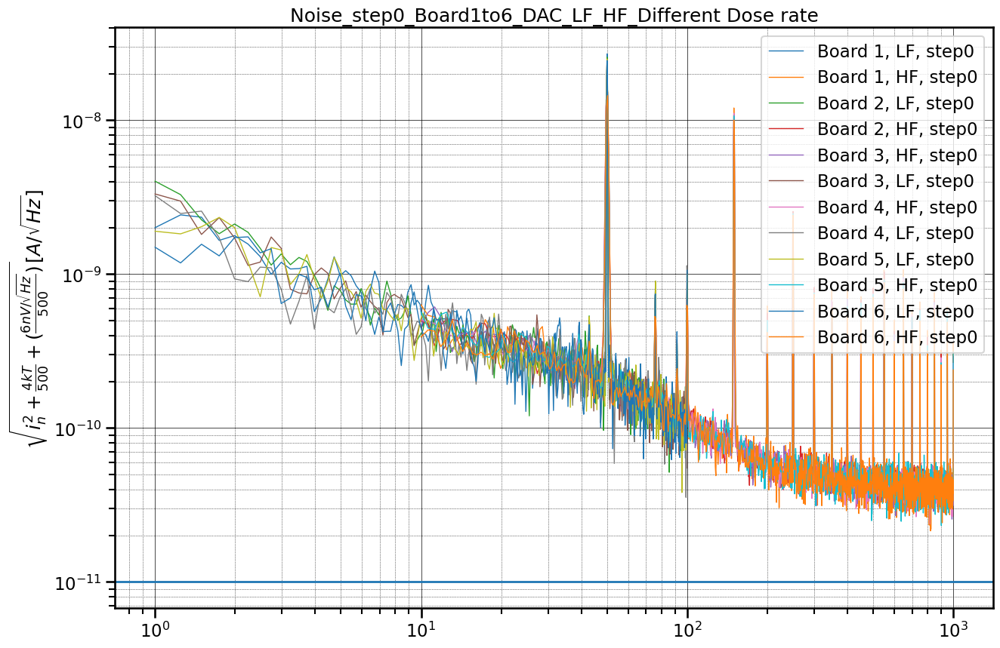

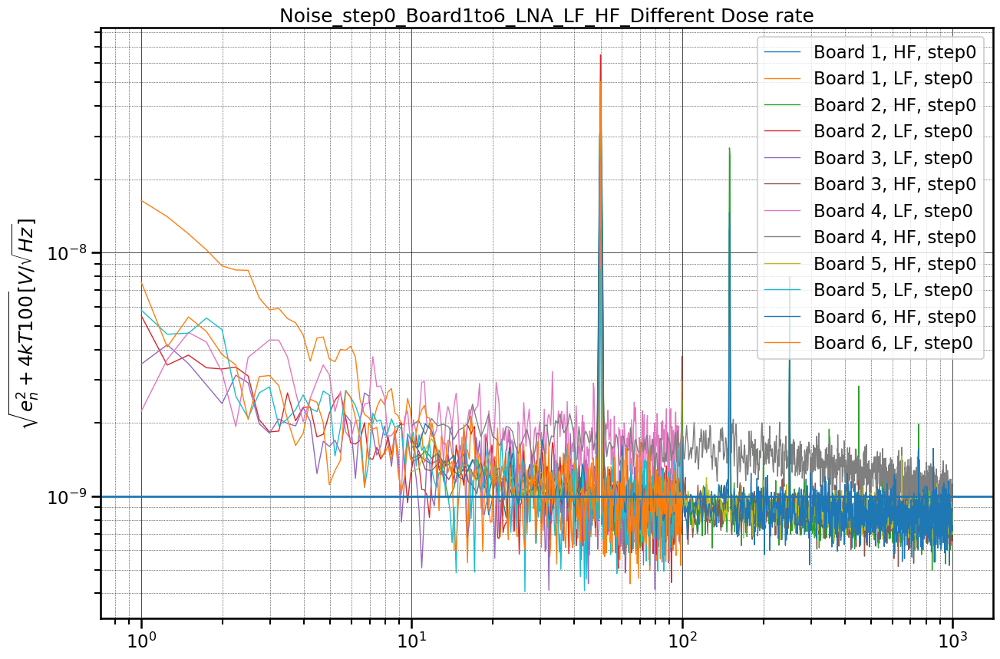

In [6]:
#Step 0
step = 'step0'

num = [[1],[2],[3],[4],[5],[6]]
#----------------

type = ['D']
F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#----------------
type = ['L']

F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#-----------------
num = [1,2,3,4,5,6]
#----------------
type = ['D']
F = ['L','H']
plot_noise_per_step(num,type, F, step)
#----------------
type = ['L']
F = ['L','H']
plot_noise_per_step(num,type, F, step)

There are 2 files in the sorted list, they are ['B1DLF1.TXT', 'B1DHF1.TXT']
There are 2 files in the sorted list, they are ['B2DLF1.TXT', 'B2DHF1.TXT']
There are 2 files in the sorted list, they are ['B3DHF1.TXT', 'B3DLF1.TXT']
There are 2 files in the sorted list, they are ['B4DHF1.TXT', 'B4DLF1.TXT']
There are 2 files in the sorted list, they are ['B5DLF1.TXT', 'B5DHF1.TXT']
There are 2 files in the sorted list, they are ['B6DLF1.TXT', 'B6DHF1.TXT']
There are 2 files in the sorted list, they are ['B1LHF1.TXT', 'B1LLF1.TXT']
There are 2 files in the sorted list, they are ['B2LHF1.TXT', 'B2LLF1.TXT']
There are 2 files in the sorted list, they are ['B3LLF1.TXT', 'B3LHF1.TXT']
There are 2 files in the sorted list, they are ['B4LLF1.TXT', 'B4LHF1.TXT']
There are 2 files in the sorted list, they are ['B5LHF1.TXT', 'B5LLF1.TXT']
There are 2 files in the sorted list, they are ['B6LHF1.TXT', 'B6LLF1.TXT']
There are 12 files in the sorted list, they are ['B1DLF1.TXT', 'B1DHF1.TXT', 'B2DLF1.TXT

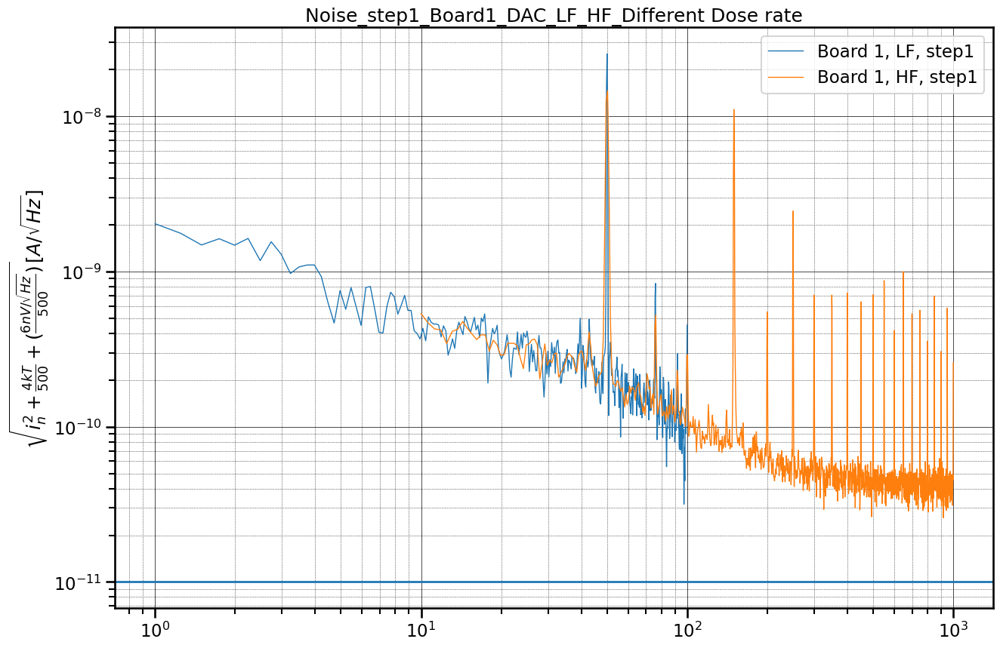

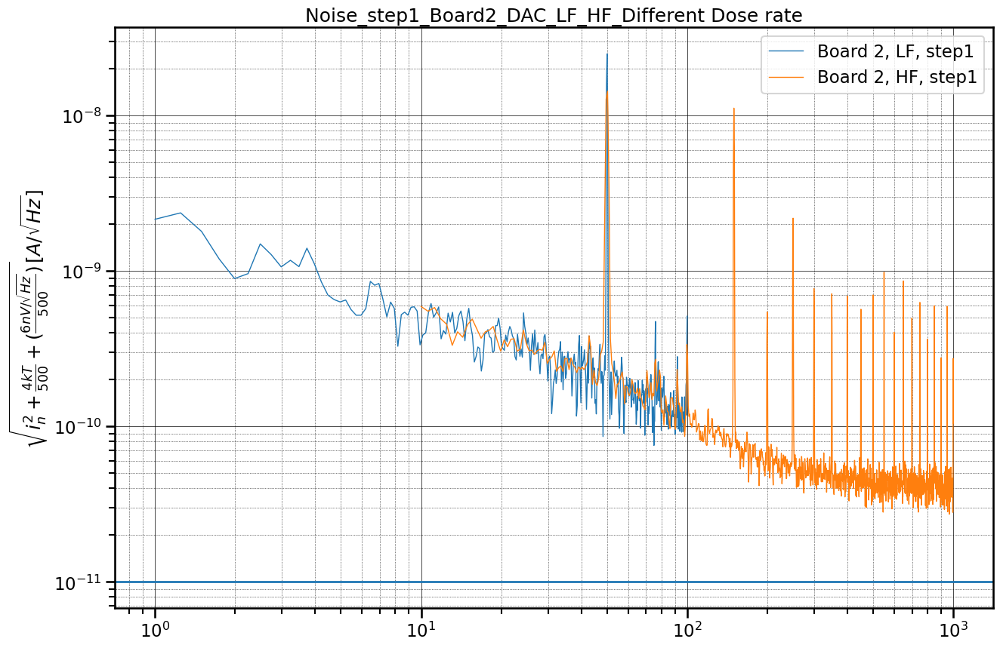

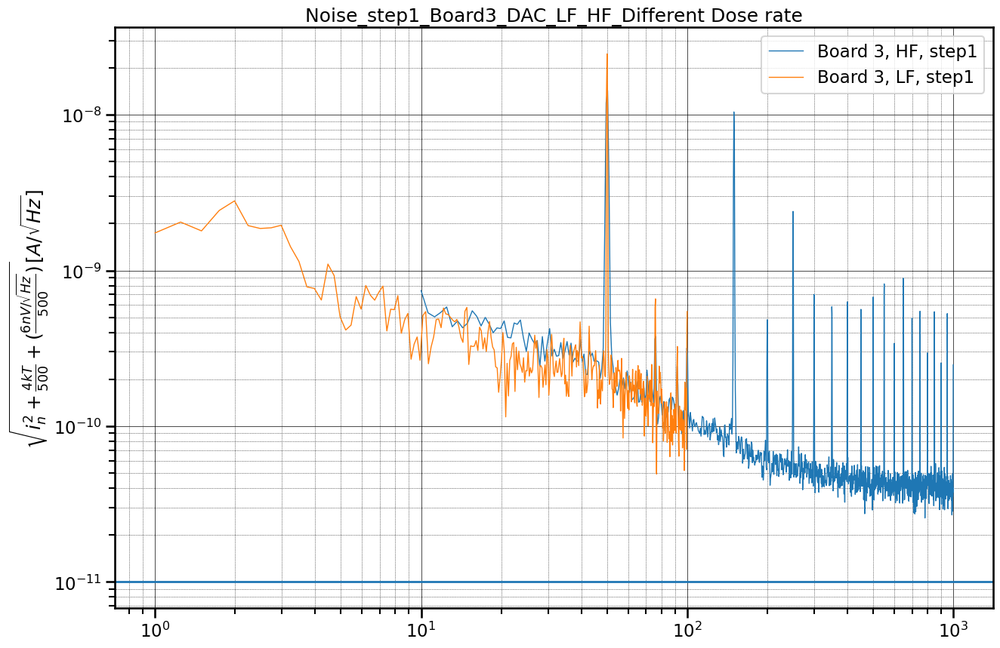

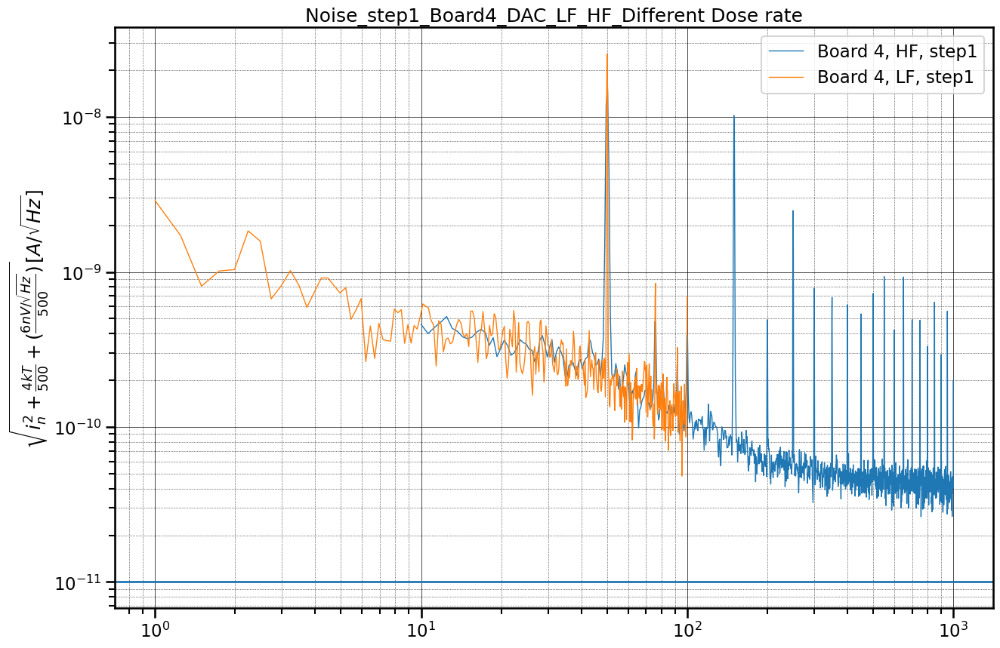

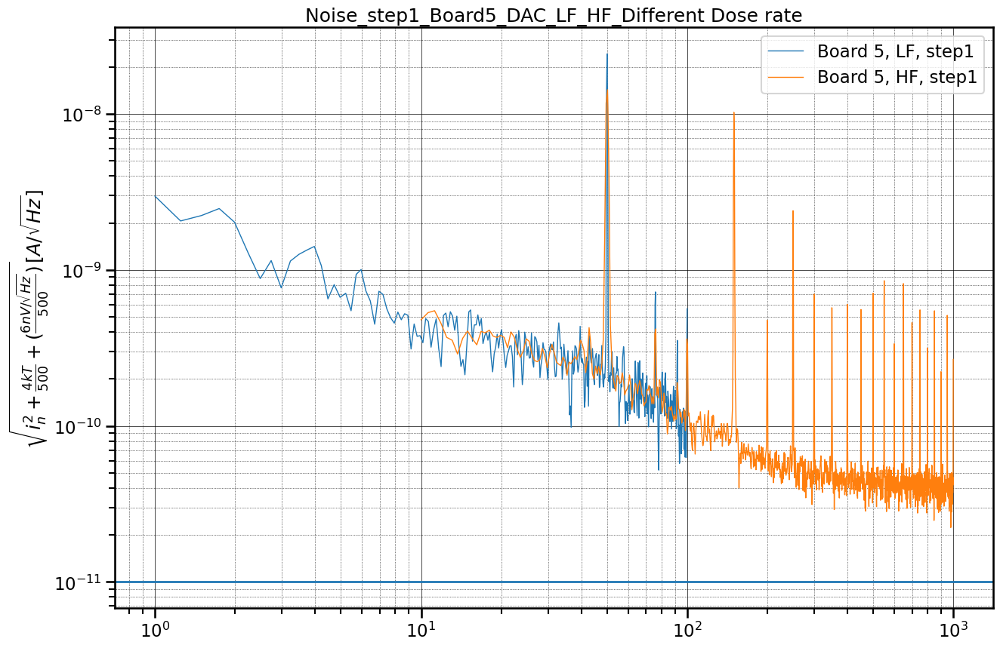

...

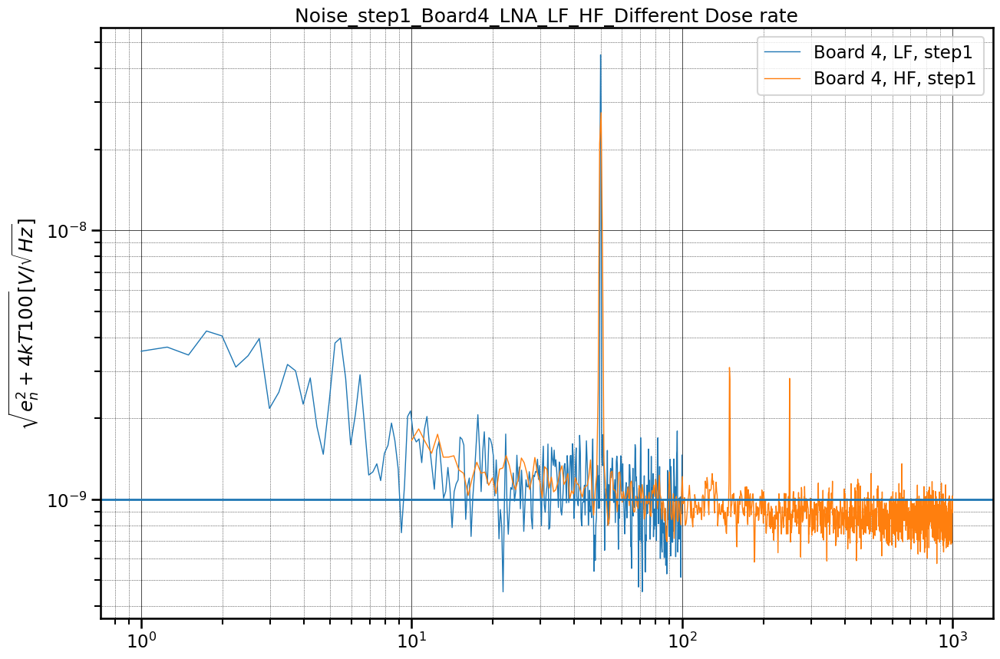

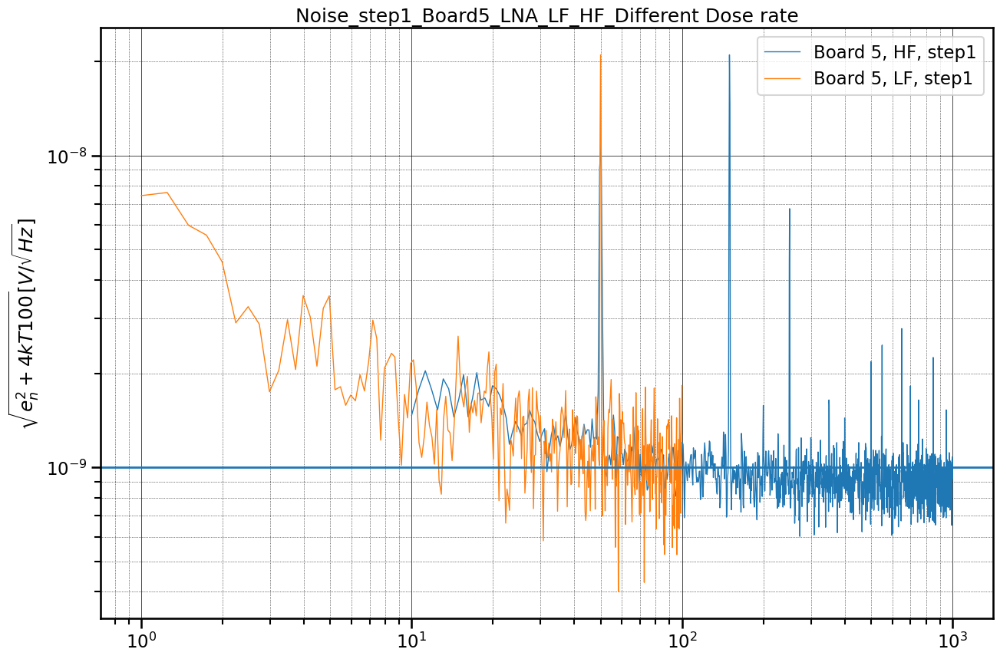

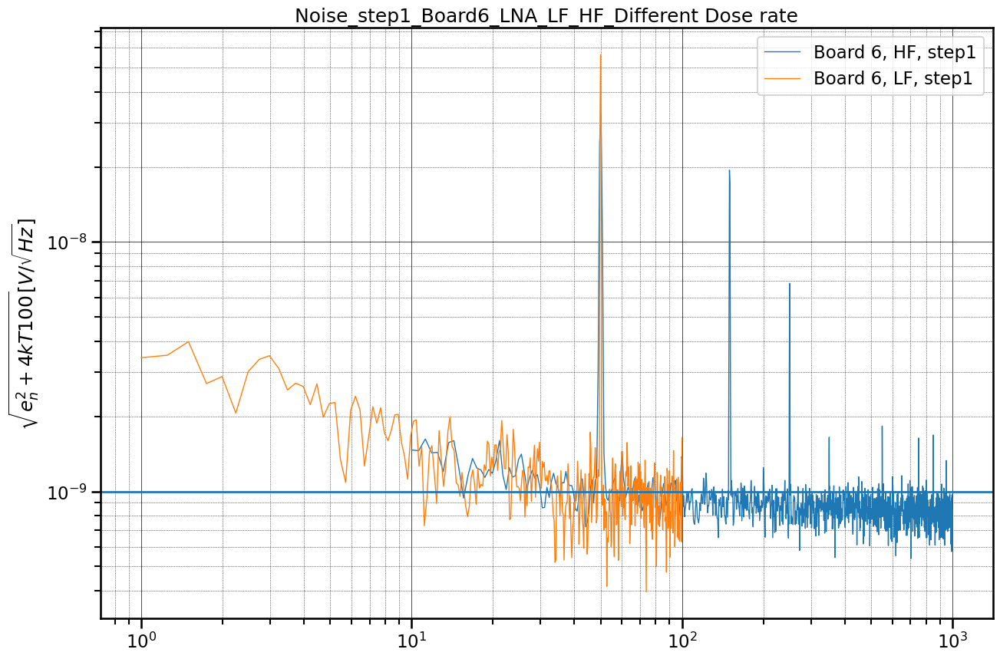

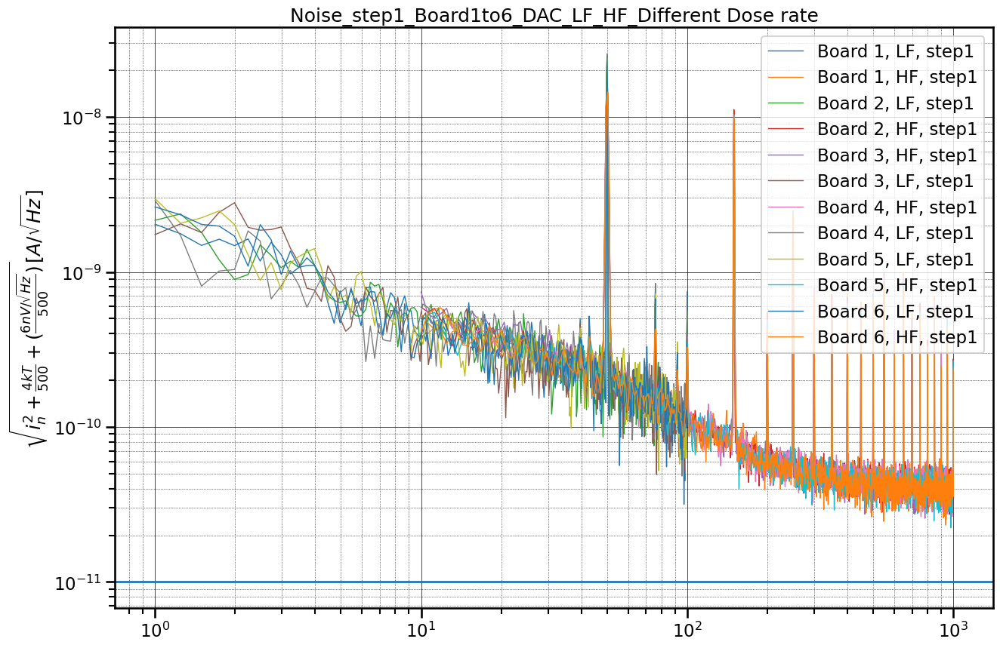

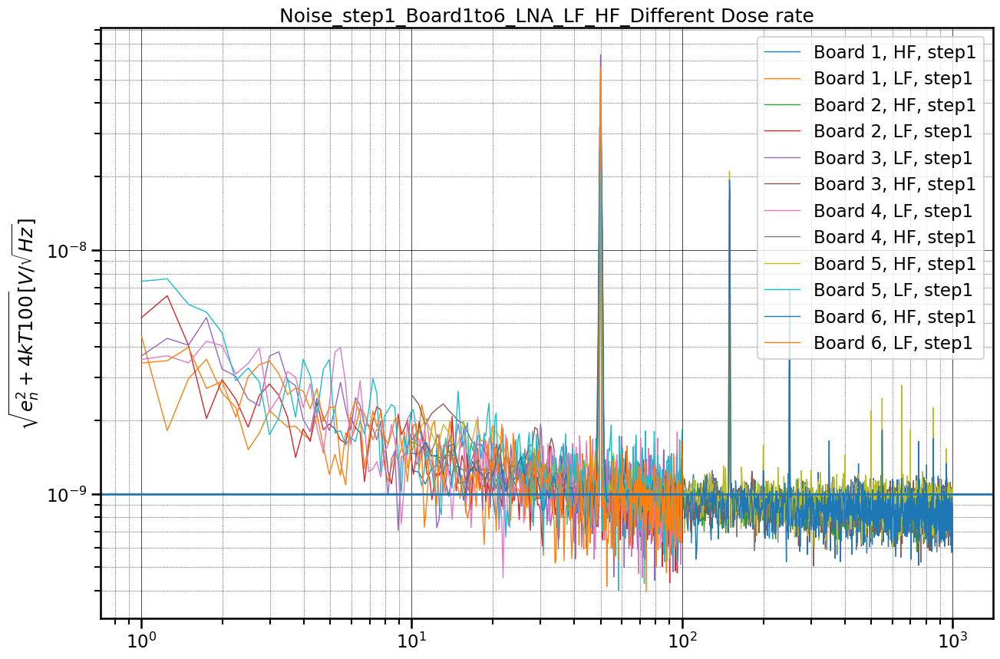

In [7]:
#Step 
step = 'step1'

num = [[1],[2],[3],[4],[5],[6]]
#----------------

type = ['D']
F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#----------------
type = ['L']

F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#-----------------
num = [1,2,3,4,5,6]
#----------------
type = ['D']
F = ['L','H']
plot_noise_per_step(num,type, F, step)
#----------------
type = ['L']
F = ['L','H']
plot_noise_per_step(num,type, F, step)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []
There are 2 files in the sorted list, they are ['B1LHF2.TXT', 'B1LLF2.TXT']
There are 2 files in the sorted list, they are ['B2LHF2.TXT', 'B2LLF2.TXT']
There are 2 files in the sorted list, they are ['B3LLF2.TXT', 'B3LHF2.TXT']


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []
There are 2 files in the sorted list, they are ['B6LHF2.TXT', 'B6LLF2.TXT']


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []
There are 8 files in the sorted list, they are ['B1LHF2.TXT', 'B1LLF2.TXT', 'B2LHF2.TXT', 'B2LLF2.TXT', 'B3LLF2.TXT', 'B3LHF2.TXT', 'B6LHF2.TXT', 'B6LLF2.TXT']


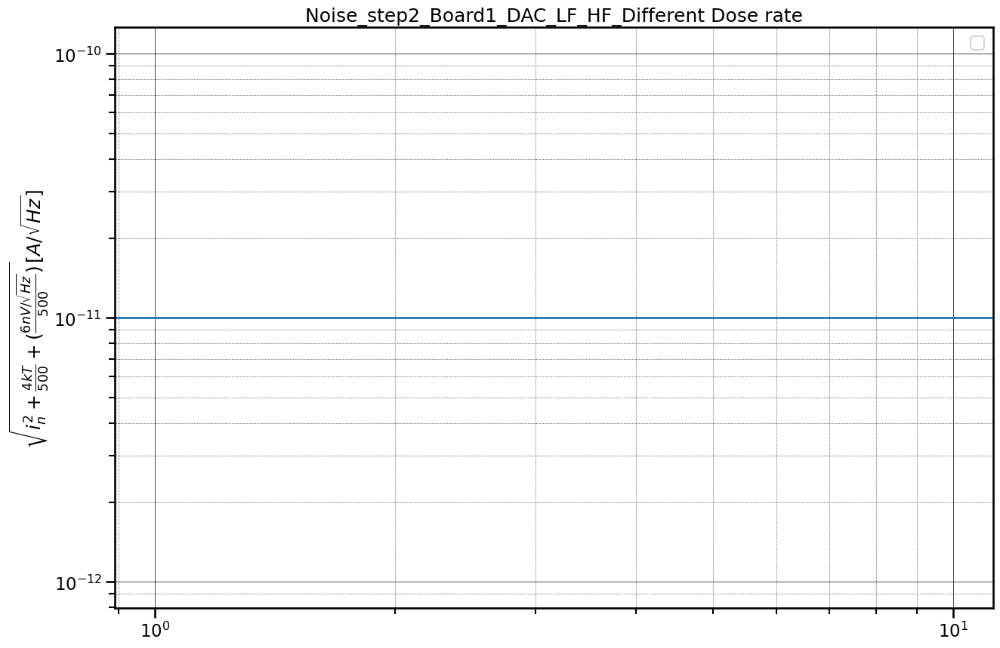

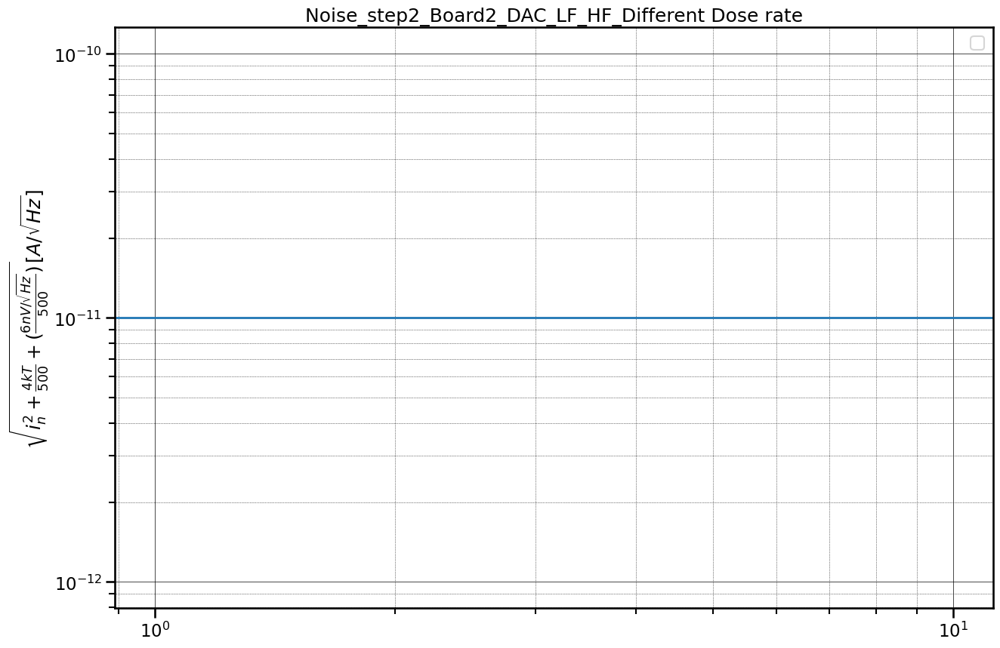

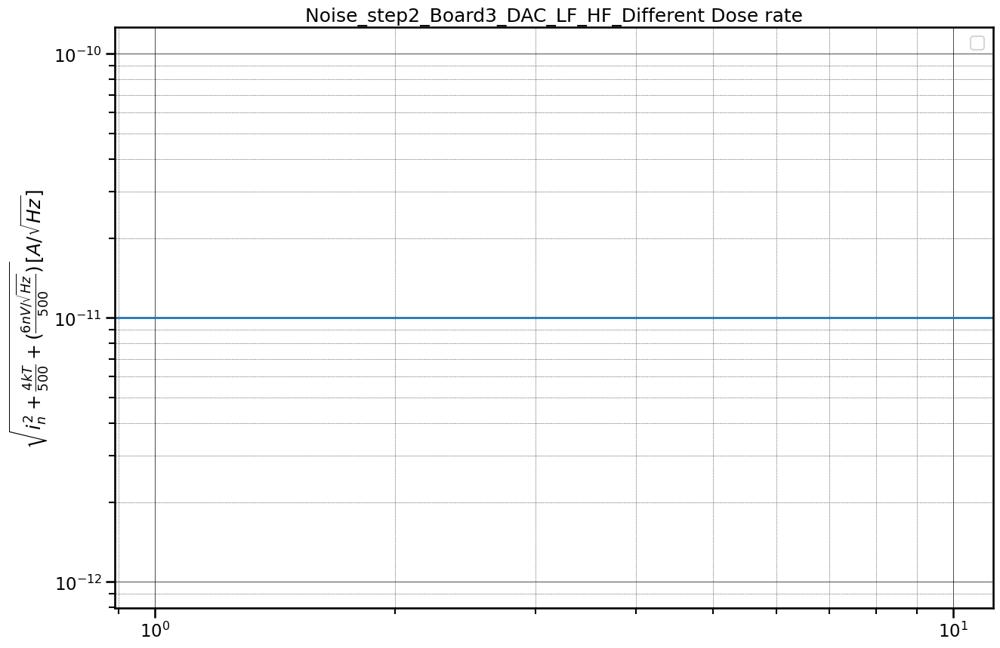

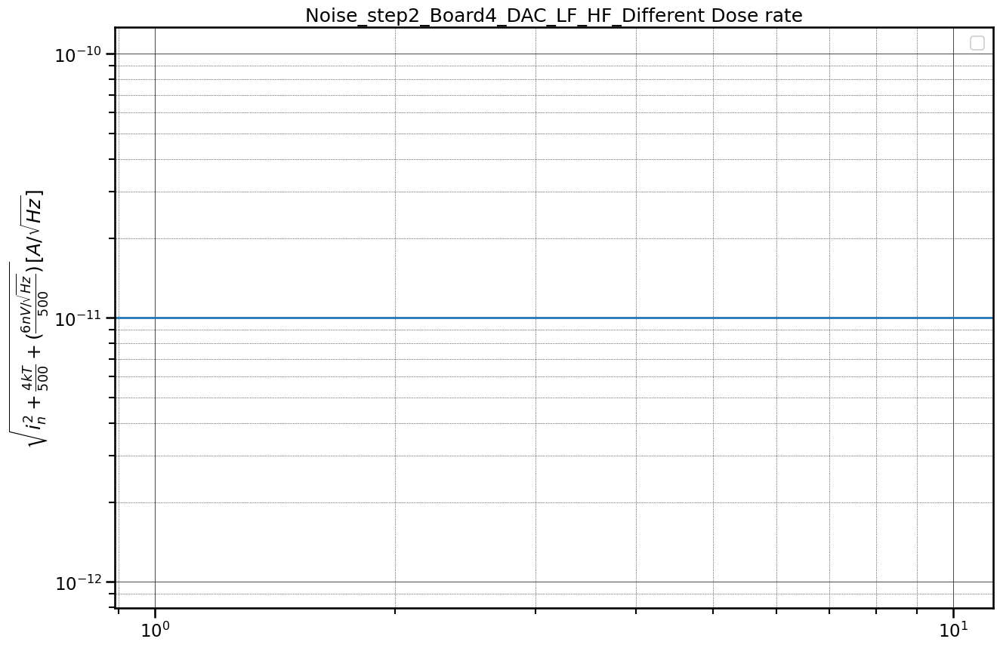

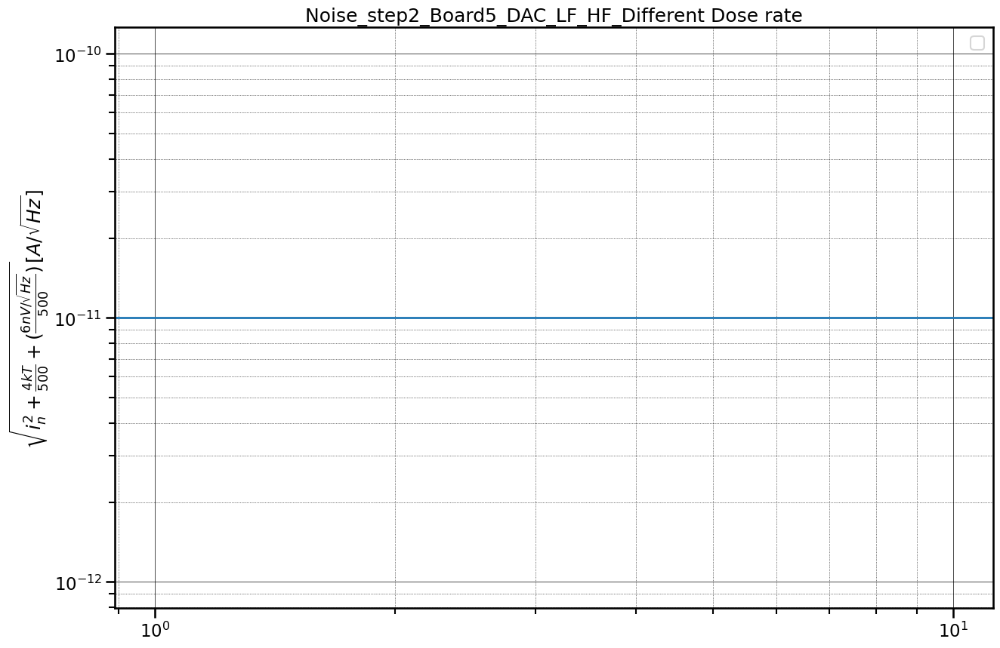

...

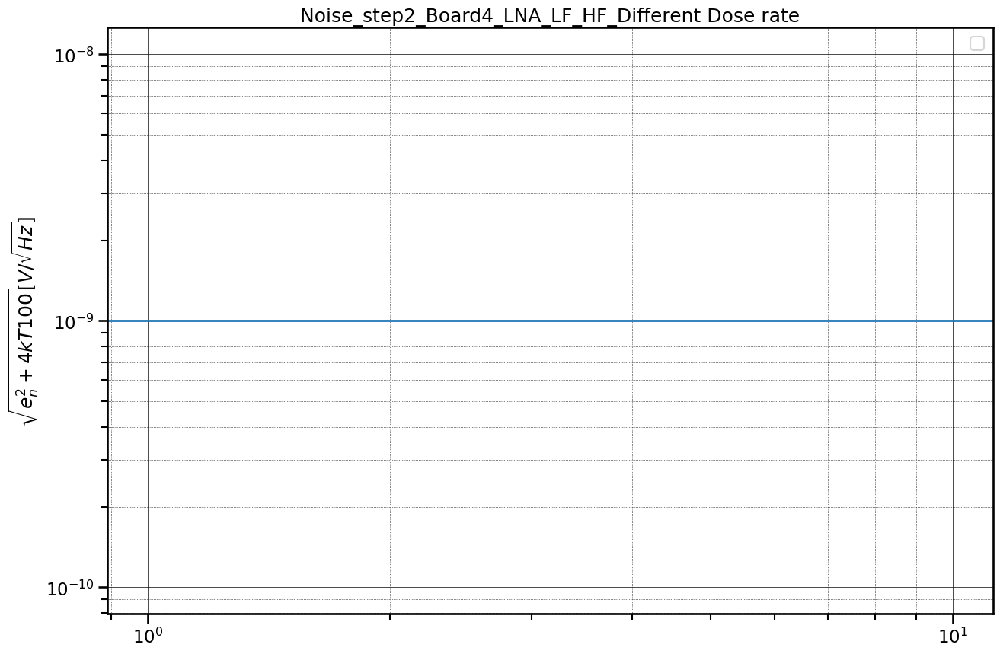

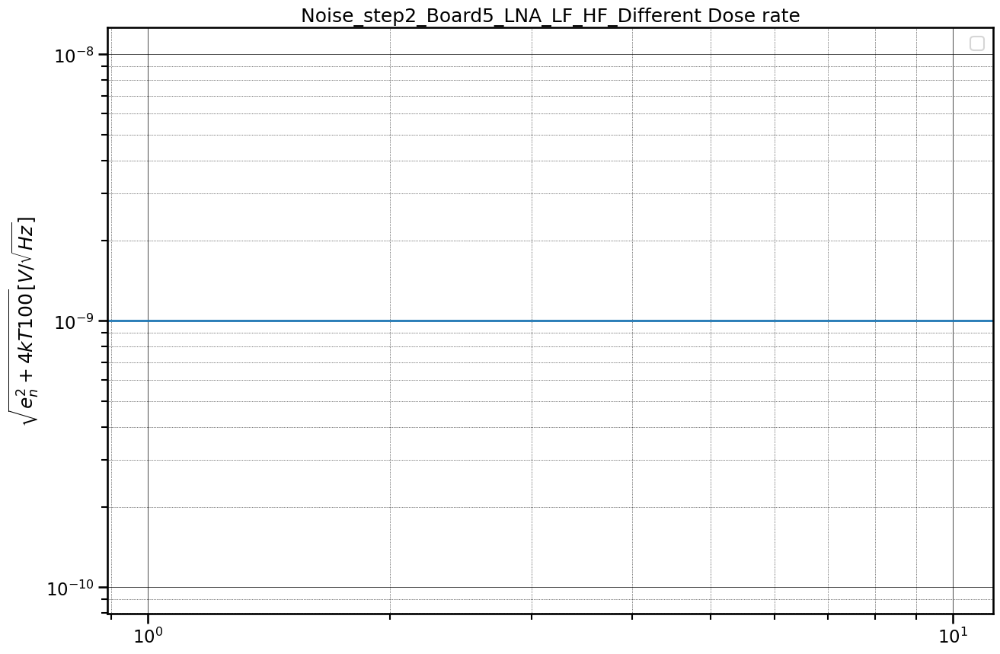

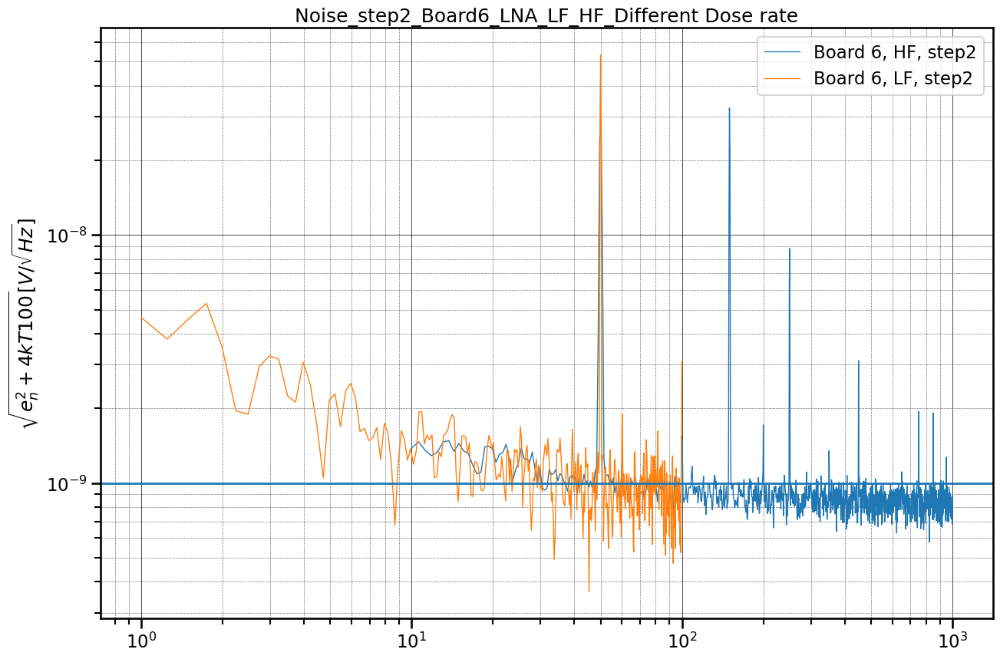

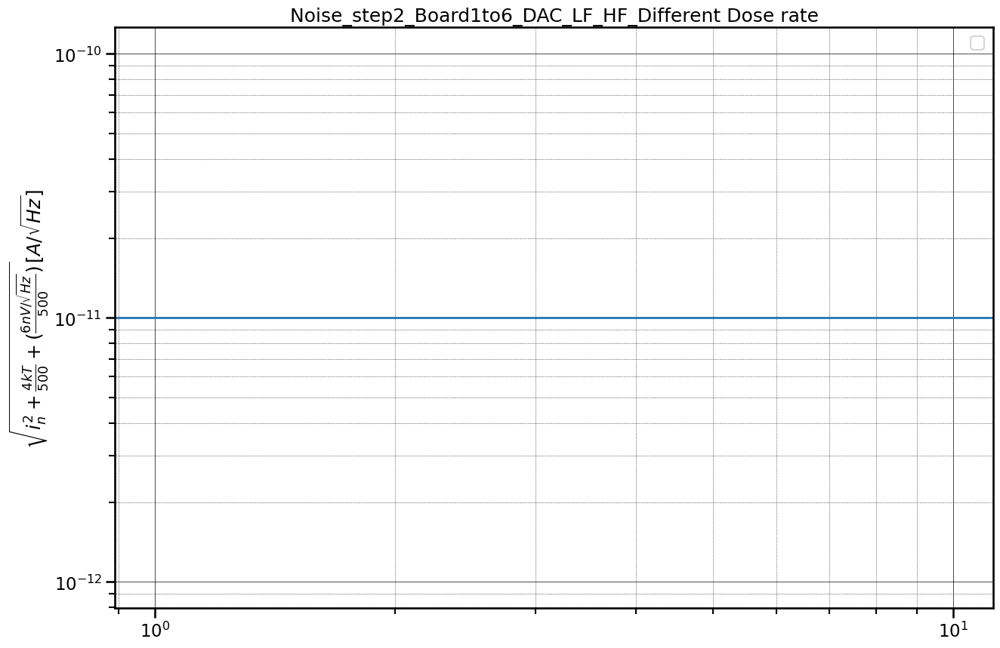

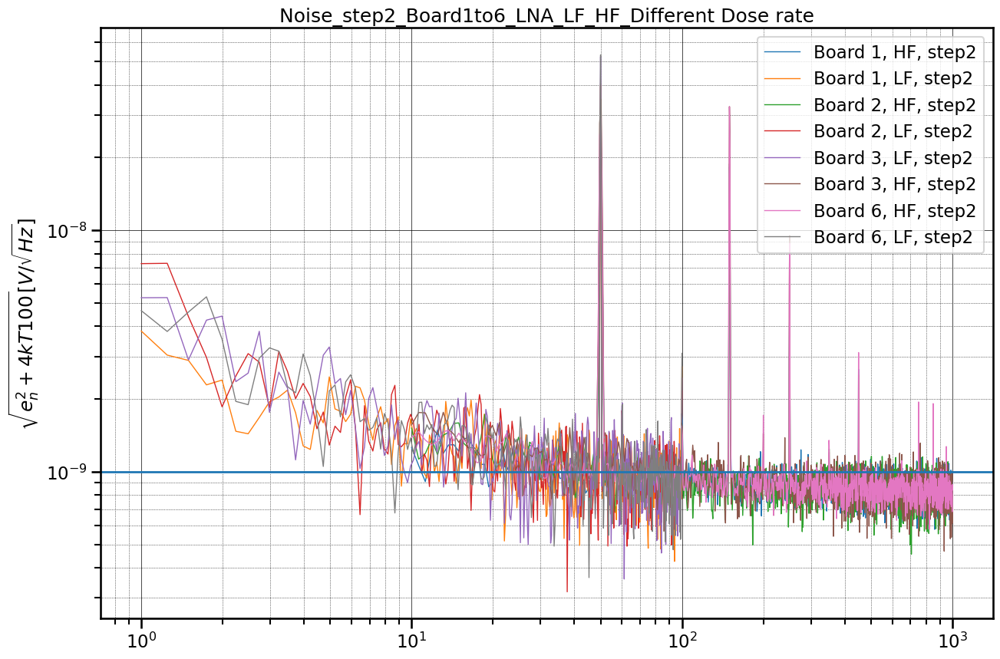

In [8]:
#Step 2
step = 'step2'

num = [[1],[2],[3],[4],[5],[6]]
#----------------

type = ['D']
F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#----------------
type = ['L']

F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#-----------------
num = [1,2,3,4,5,6]
#----------------
type = ['D']
F = ['L','H']
plot_noise_per_step(num,type, F, step)
#----------------
type = ['L']
F = ['L','H']
plot_noise_per_step(num,type, F, step)

There are 2 files in the sorted list, they are ['B1DLF3.TXT', 'B1DHF3.TXT']
There are 2 files in the sorted list, they are ['B2DLF3.TXT', 'B2DHF3.TXT']
There are 2 files in the sorted list, they are ['B3DHF3.TXT', 'B3DLF3.TXT']
There are 2 files in the sorted list, they are ['B4DHF3.TXT', 'B4DLF3.TXT']
There are 2 files in the sorted list, they are ['B5DLF3.TXT', 'B5DHF3.TXT']
There are 2 files in the sorted list, they are ['B6DLF3.TXT', 'B6DHF3.TXT']
There are 1 files in the sorted list, they are ['B1LLF3.TXT']
There are 1 files in the sorted list, they are ['B2LLF3.TXT']
There are 2 files in the sorted list, they are ['B3LLF3.TXT', 'B3LHF3.TXT']
There are 2 files in the sorted list, they are ['B4LLF3.TXT', 'B4LHF3.TXT']
There are 1 files in the sorted list, they are ['B5LLF3.TXT']
There are 1 files in the sorted list, they are ['B6LLF3.TXT']
There are 12 files in the sorted list, they are ['B1DLF3.TXT', 'B1DHF3.TXT', 'B2DLF3.TXT', 'B2DHF3.TXT', 'B3DHF3.TXT', 'B3DLF3.TXT', 'B4DHF3.TXT

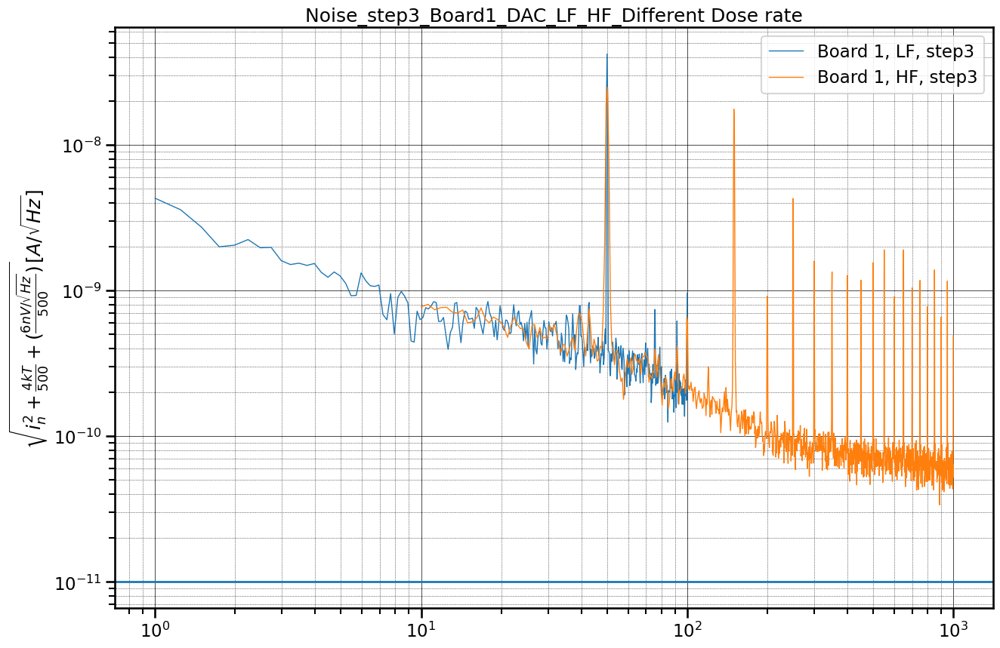

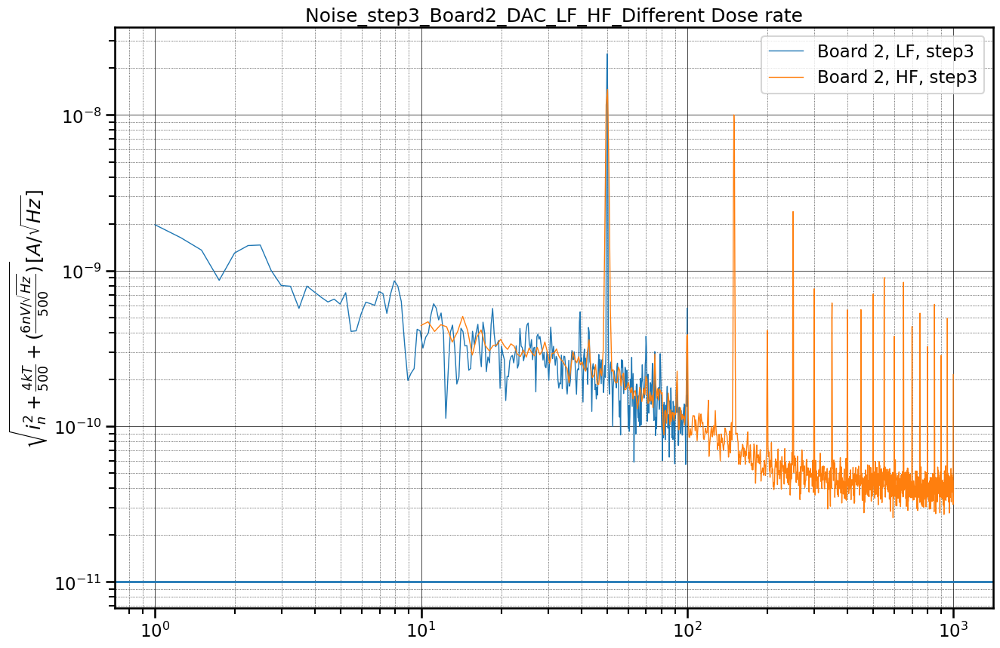

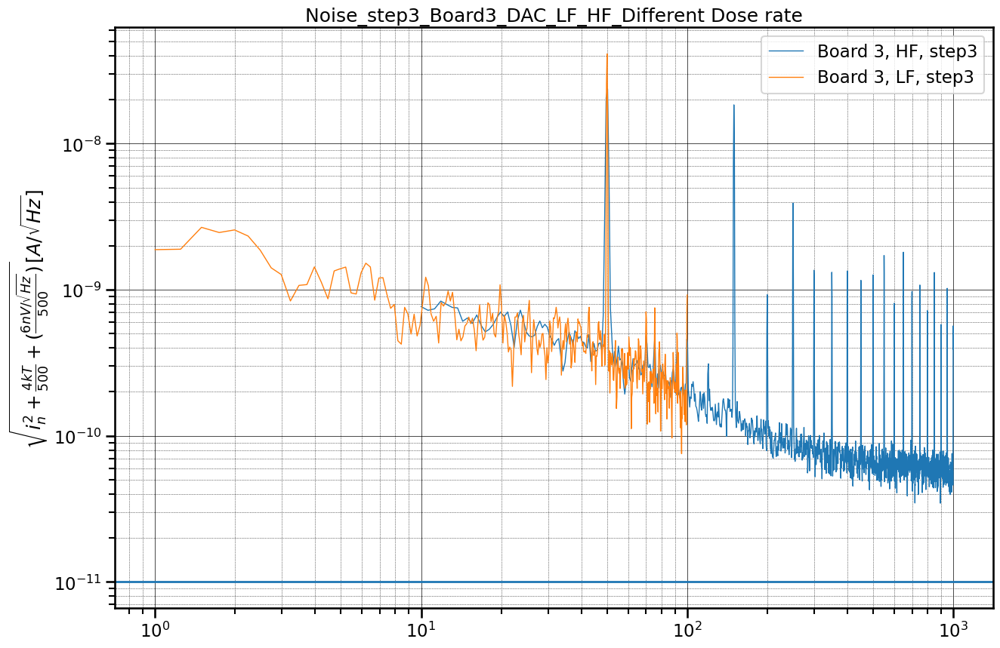

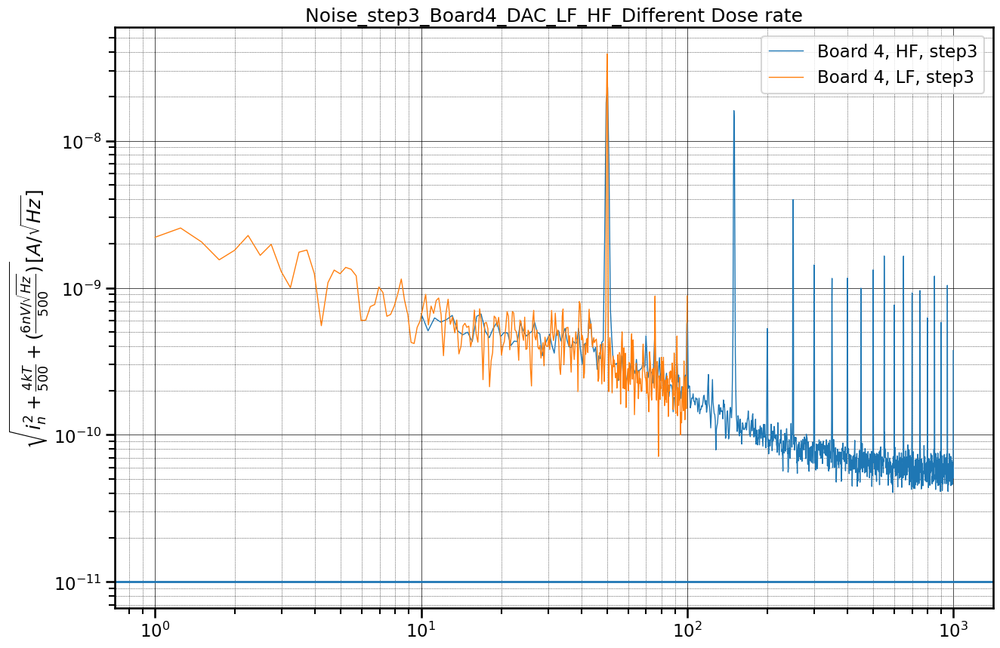

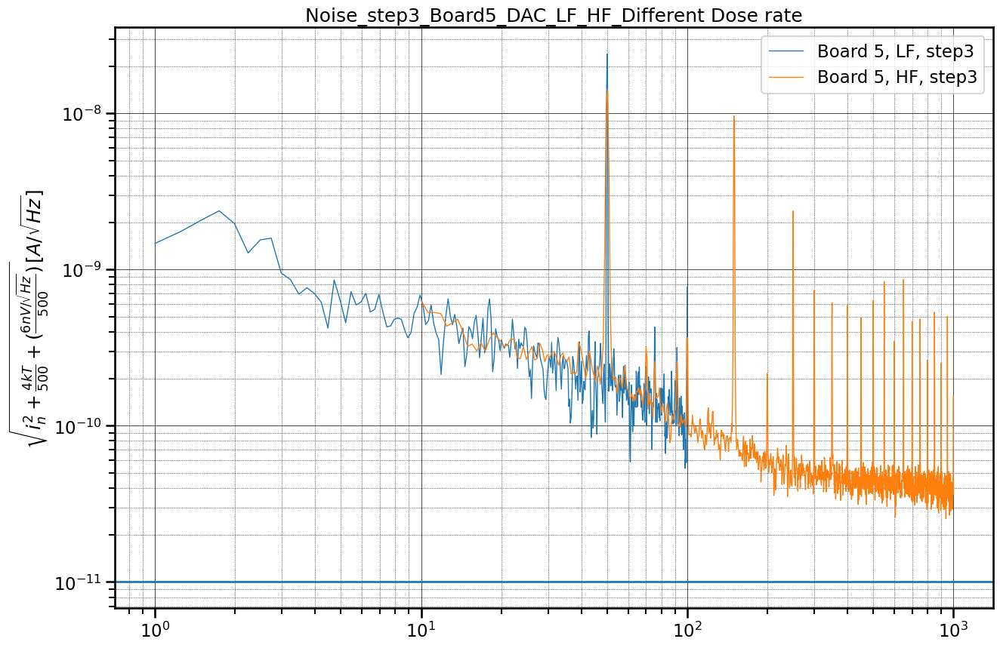

...

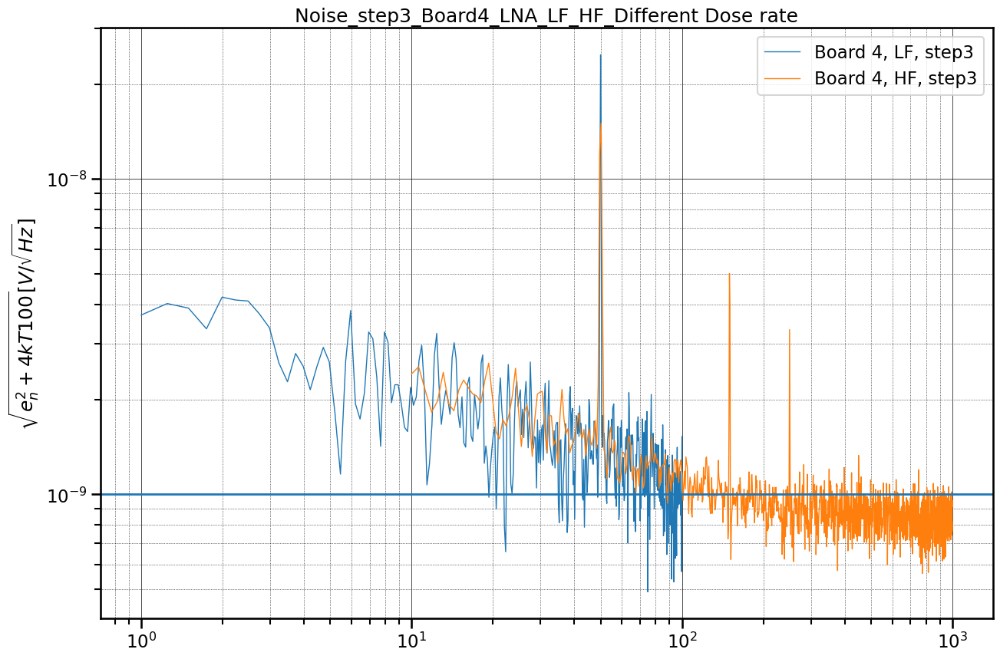

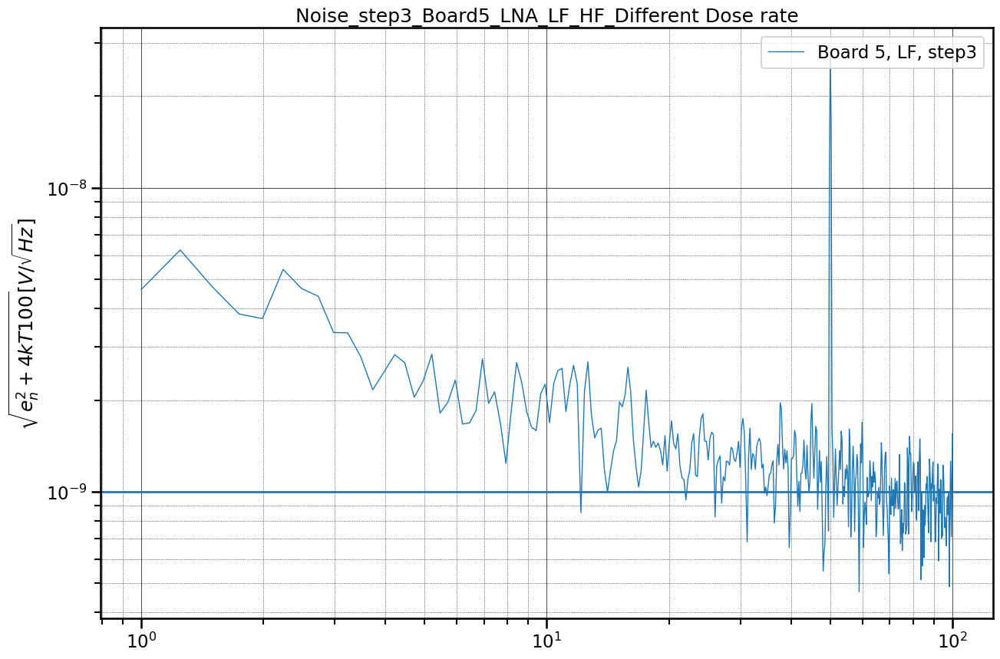

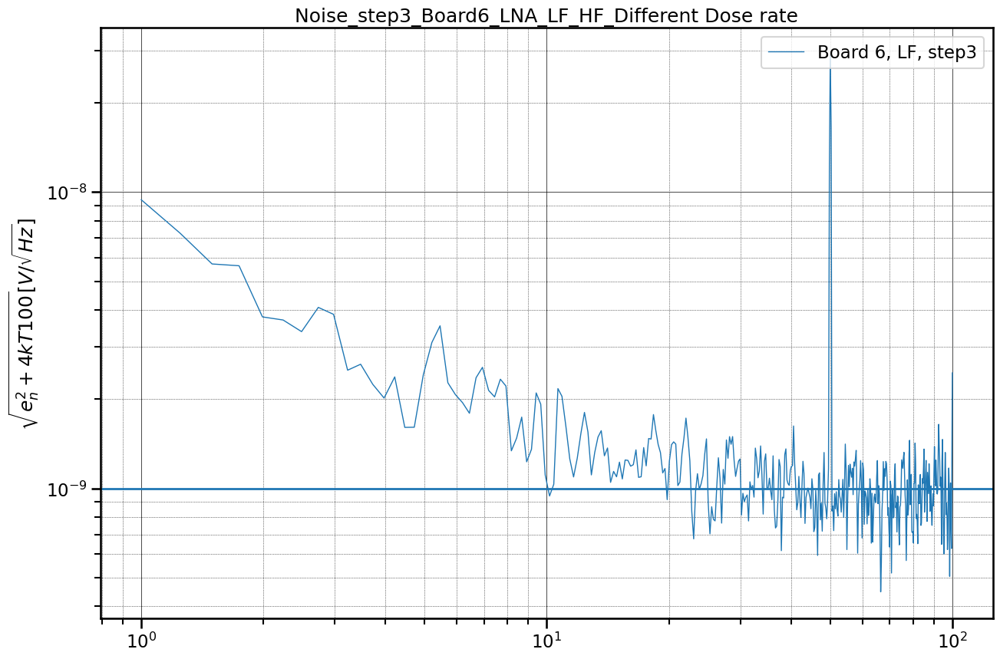

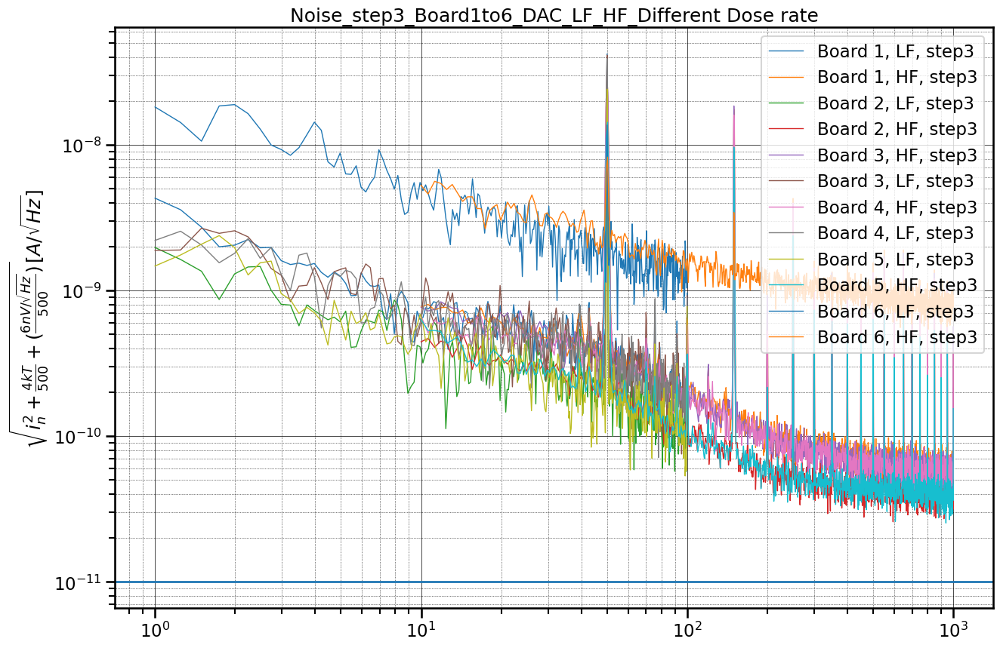

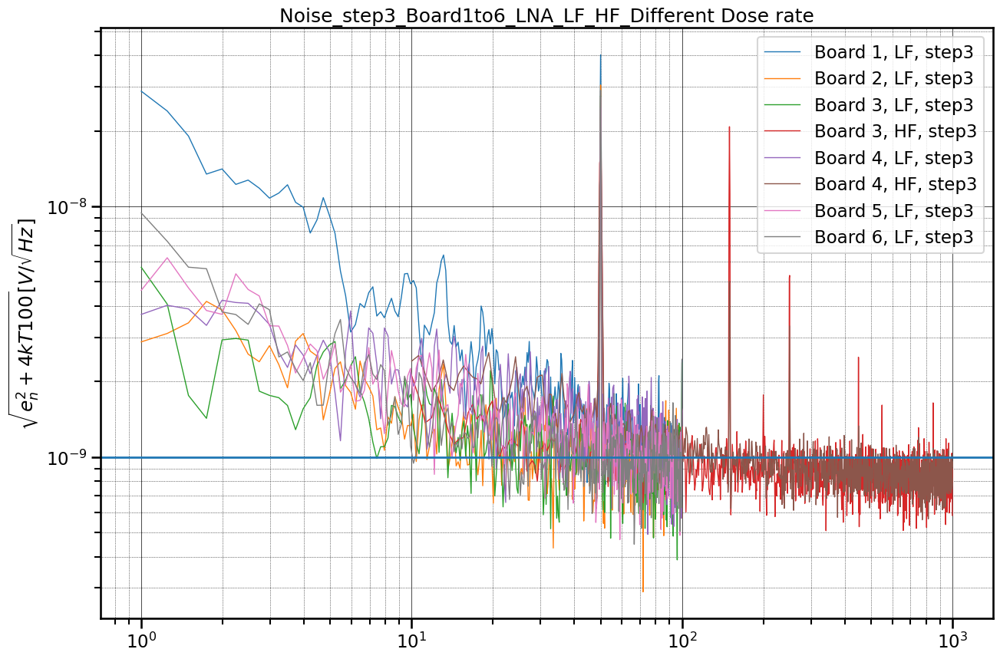

In [9]:
#Step 
step = 'step3'

num = [[1],[2],[3],[4],[5],[6]]
#----------------

type = ['D']
F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#----------------
type = ['L']

F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#-----------------
num = [1,2,3,4,5,6]
#----------------
type = ['D']
F = ['L','H']
plot_noise_per_step(num,type, F, step)
#----------------
type = ['L']
F = ['L','H']
plot_noise_per_step(num,type, F, step)

There are 2 files in the sorted list, they are ['B1DHF4.TXT', 'B1DLF4.TXT']
There are 2 files in the sorted list, they are ['B2DHF4.TXT', 'B2DLF4.TXT']
There are 2 files in the sorted list, they are ['B3DLF4.TXT', 'B3DHF4.TXT']
There are 2 files in the sorted list, they are ['B4DLF4.TXT', 'B4DHF4.TXT']
There are 2 files in the sorted list, they are ['B5DHF4.TXT', 'B5DLF4.TXT']
There are 2 files in the sorted list, they are ['B6DHF4.TXT', 'B6DLF4.TXT']
There are 1 files in the sorted list, they are ['B1LLF4.TXT']
There are 1 files in the sorted list, they are ['B2LLF4.TXT']
There are 2 files in the sorted list, they are ['B3LHF4.TXT', 'B3LLF4.TXT']
There are 2 files in the sorted list, they are ['B4LHF4.TXT', 'B4LLF4.TXT']
There are 2 files in the sorted list, they are ['B5LLF4.TXT', 'B5LHF4.TXT']
There are 2 files in the sorted list, they are ['B6LLF4.TXT', 'B6LHF4.TXT']
There are 12 files in the sorted list, they are ['B1DHF4.TXT', 'B1DLF4.TXT', 'B2DHF4.TXT', 'B2DLF4.TXT', 'B3DLF4.TXT

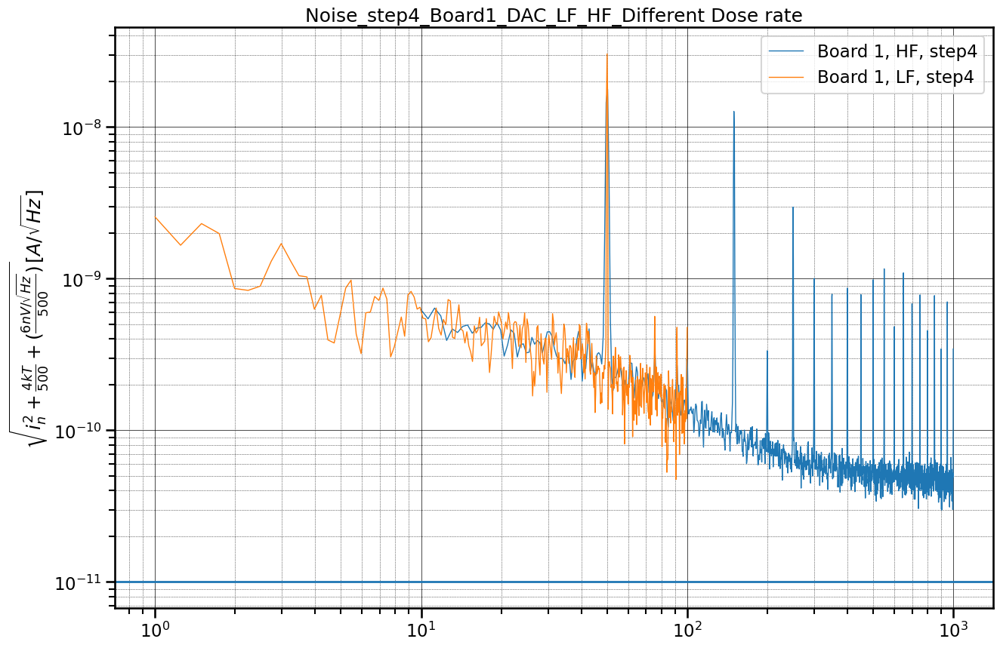

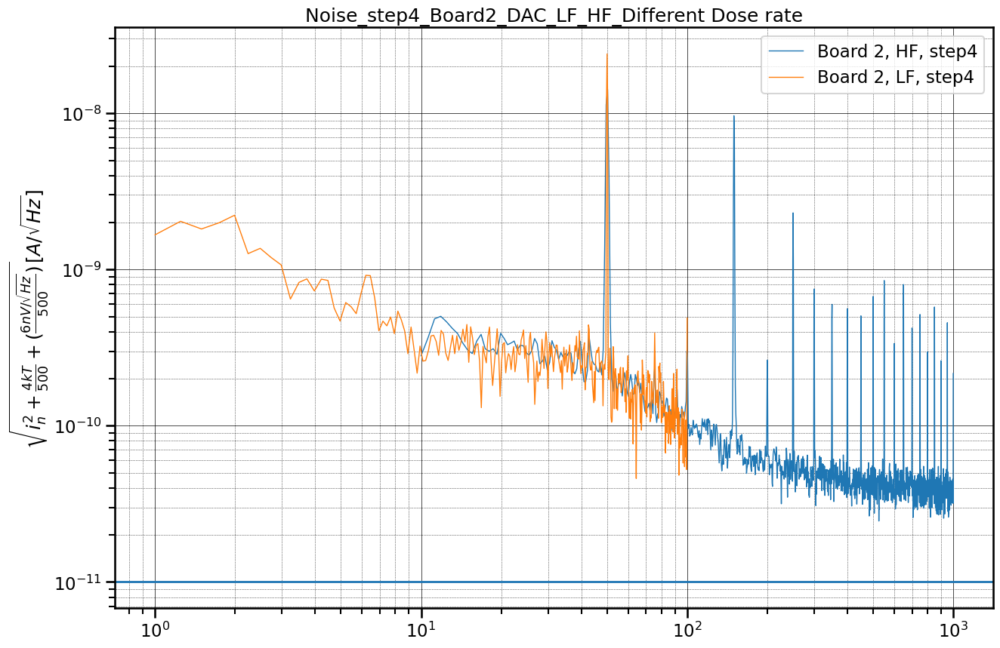

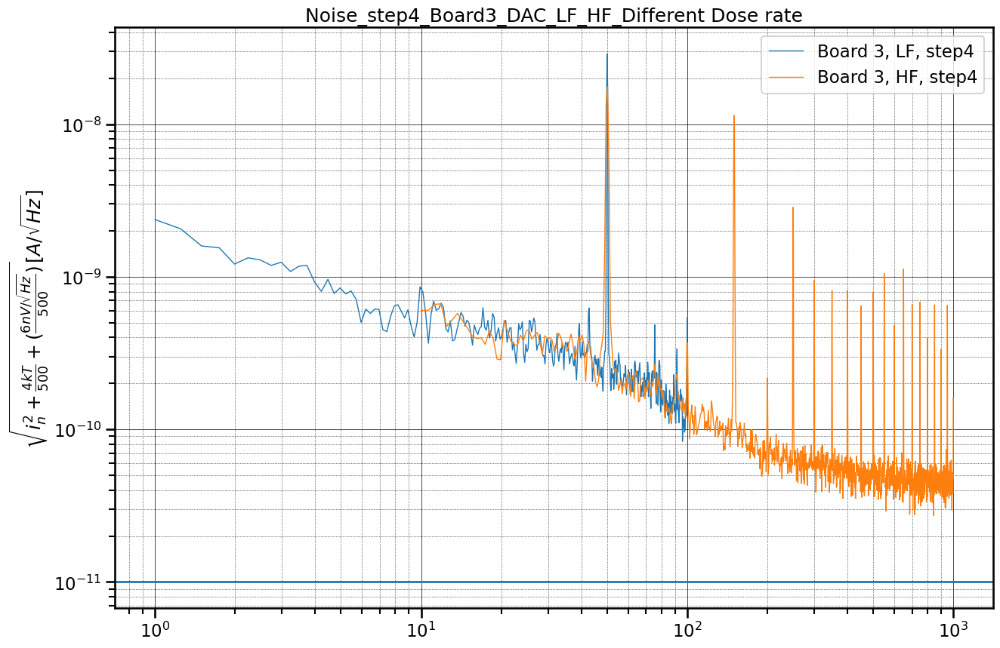

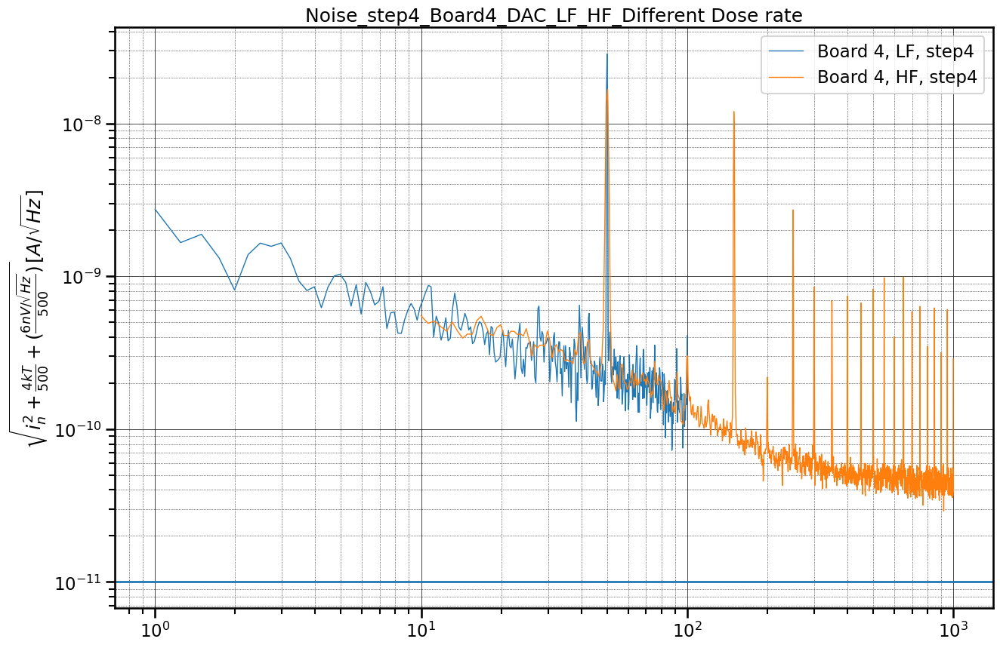

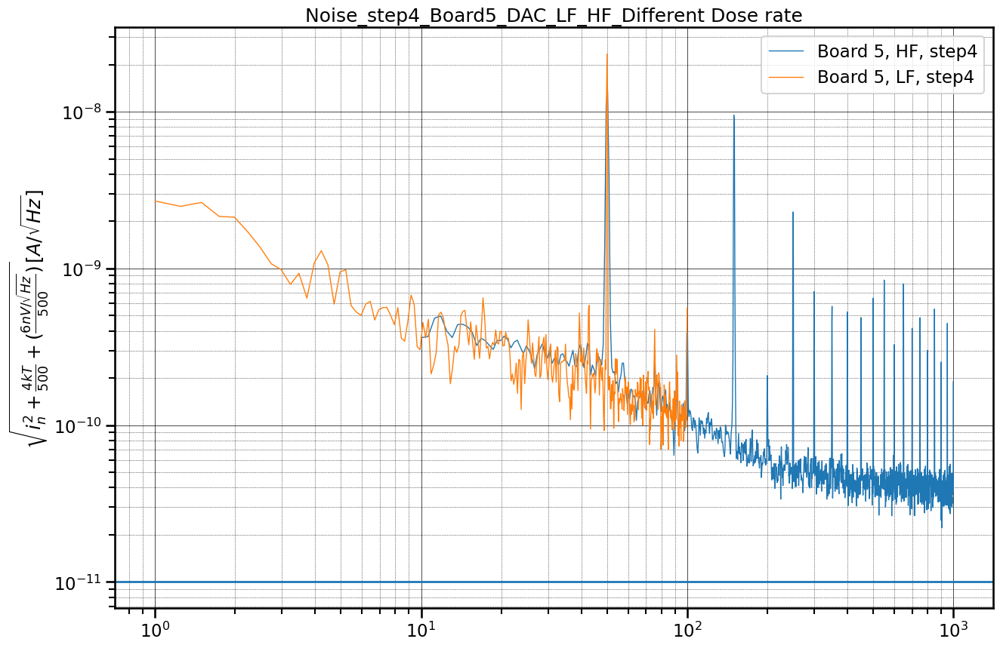

...

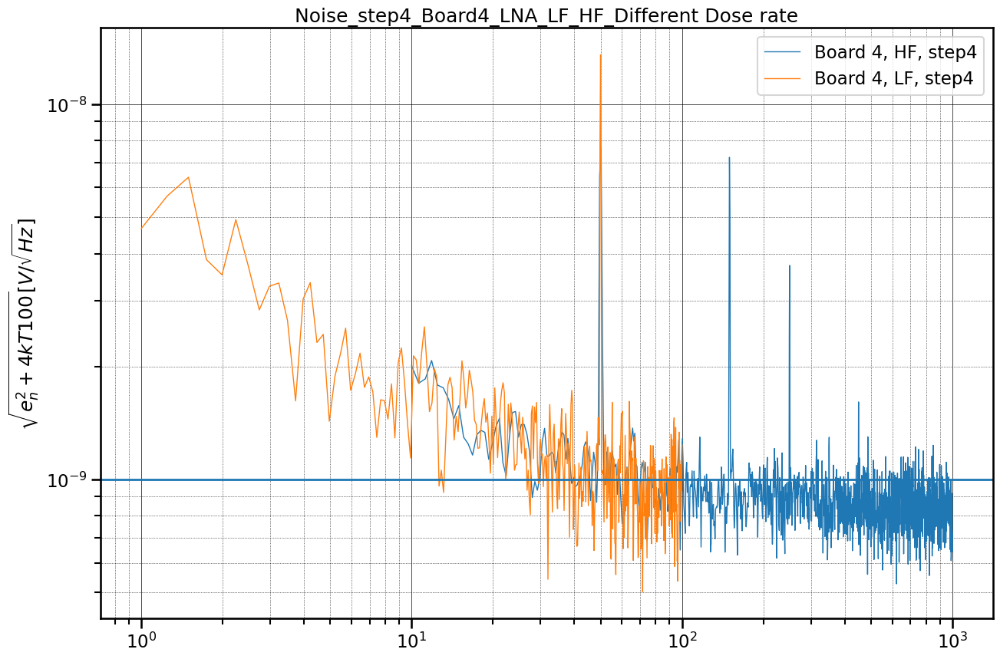

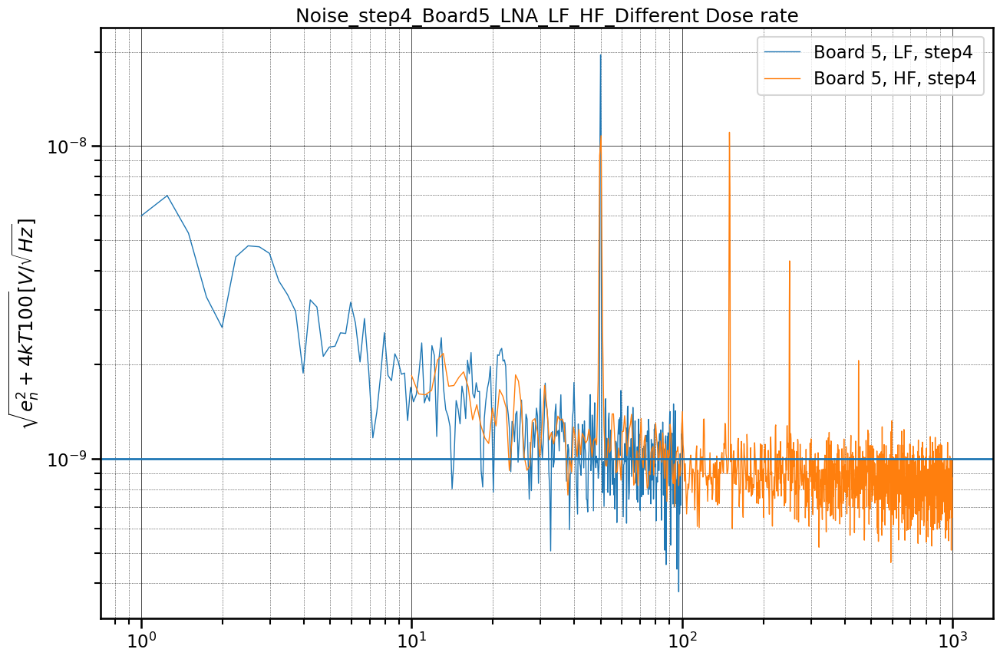

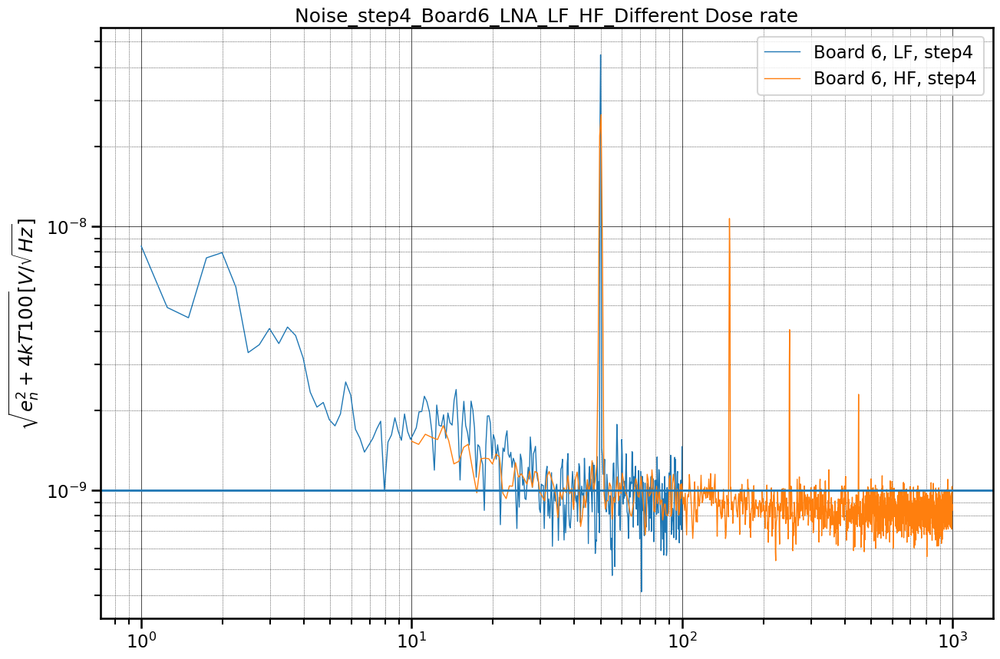

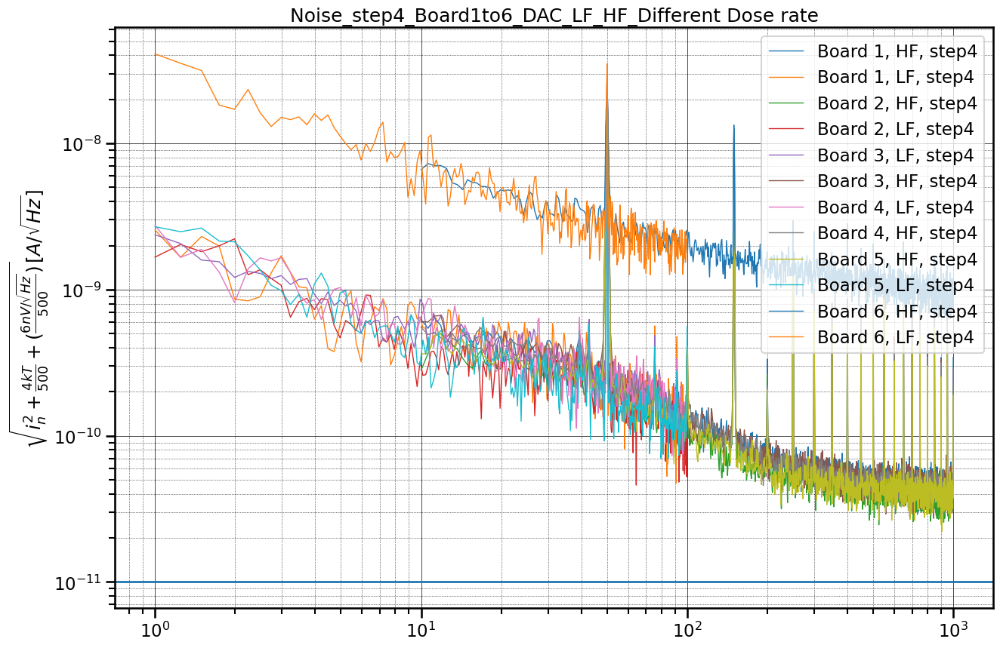

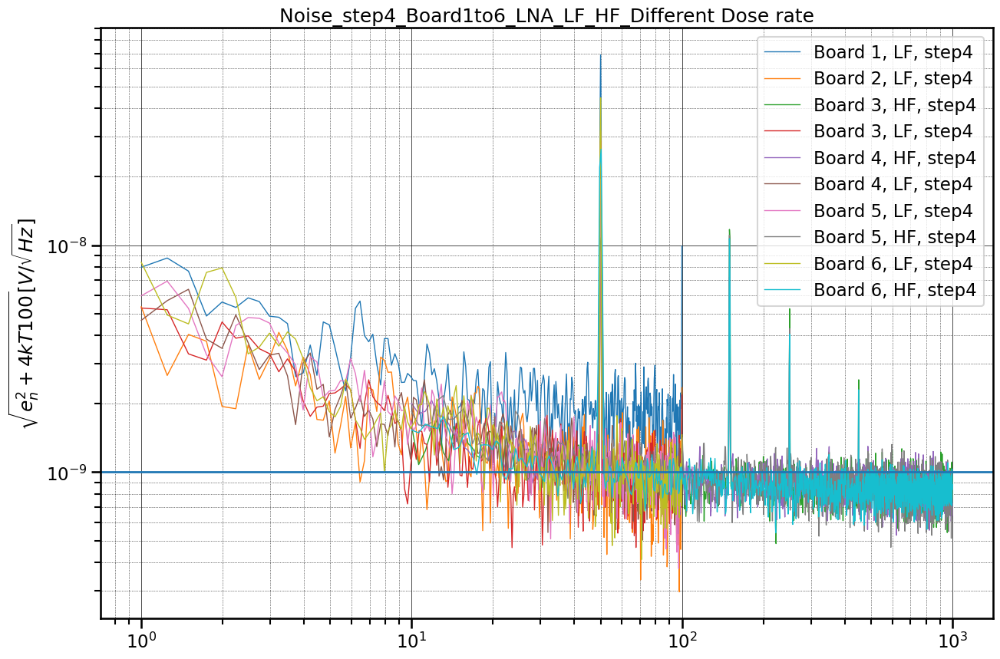

In [10]:
#Step 
step = 'step4'

num = [[1],[2],[3],[4],[5],[6]]
#----------------

type = ['D']
F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#----------------
type = ['L']

F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#-----------------
num = [1,2,3,4,5,6]
#----------------
type = ['D']
F = ['L','H']
plot_noise_per_step(num,type, F, step)
#----------------
type = ['L']
F = ['L','H']
plot_noise_per_step(num,type, F, step)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []
There are 2 files in the sorted list, they are ['B3DLF5.TXT', 'B3DHF5.TXT']
There are 2 files in the sorted list, they are ['B4DLF5.TXT', 'B4DHF5.TXT']
There are 2 files in the sorted list, they are ['B5DHF5.TXT', 'B5DLF5.TXT']
There are 1 files in the sorted list, they are ['B6DLF5.TXT']


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []
There are 2 files in the sorted list, they are ['B3LHF5.TXT', 'B3LLF5.TXT']
There are 2 files in the sorted list, they are ['B4LHF5.TXT', 'B4LLF5.TXT']
There are 2 files in the sorted list, they are ['B5LLF5.TXT', 'B5LHF5.TXT']


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []
There are 7 files in the sorted list, they are ['B3DLF5.TXT', 'B3DHF5.TXT', 'B4DLF5.TXT', 'B4DHF5.TXT', 'B5DHF5.TXT', 'B5DLF5.TXT', 'B6DLF5.TXT']
There are 6 files in the sorted list, they are ['B3LHF5.TXT', 'B3LLF5.TXT', 'B4LHF5.TXT', 'B4LLF5.TXT', 'B5LLF5.TXT', 'B5LHF5.TXT']


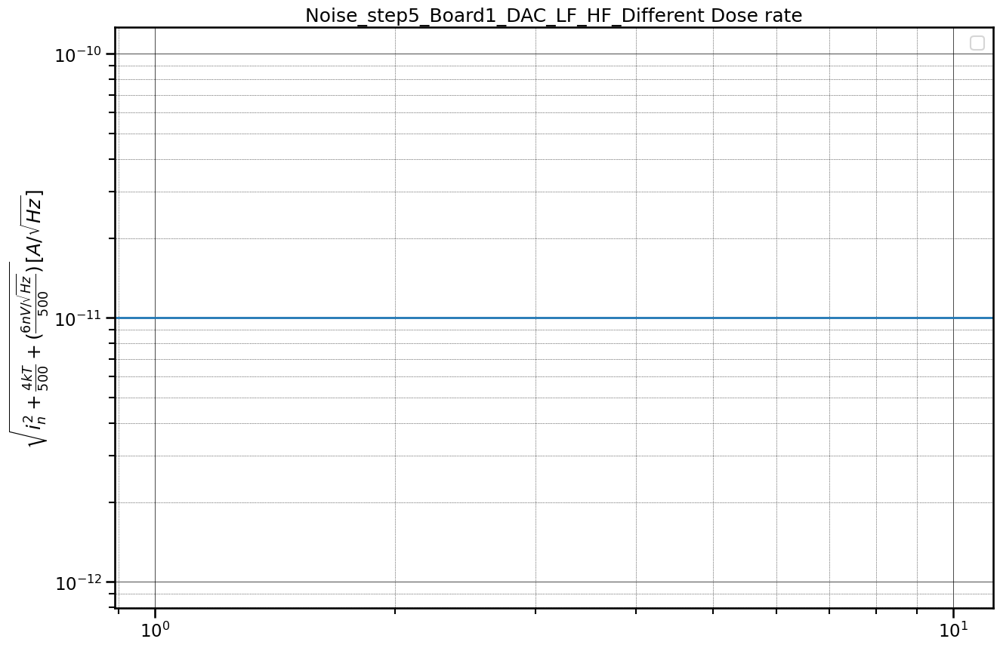

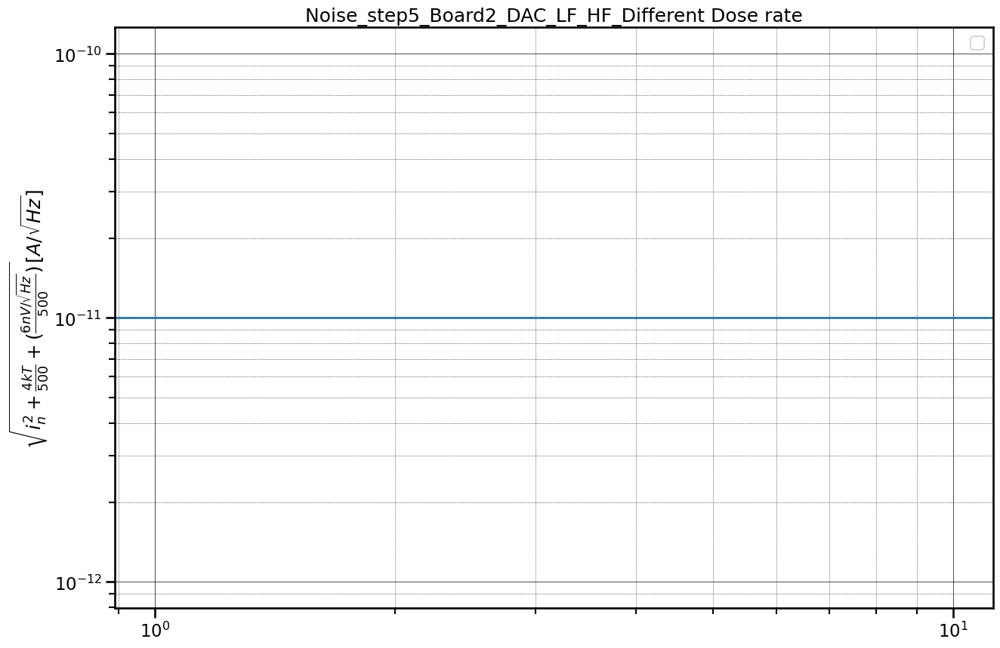

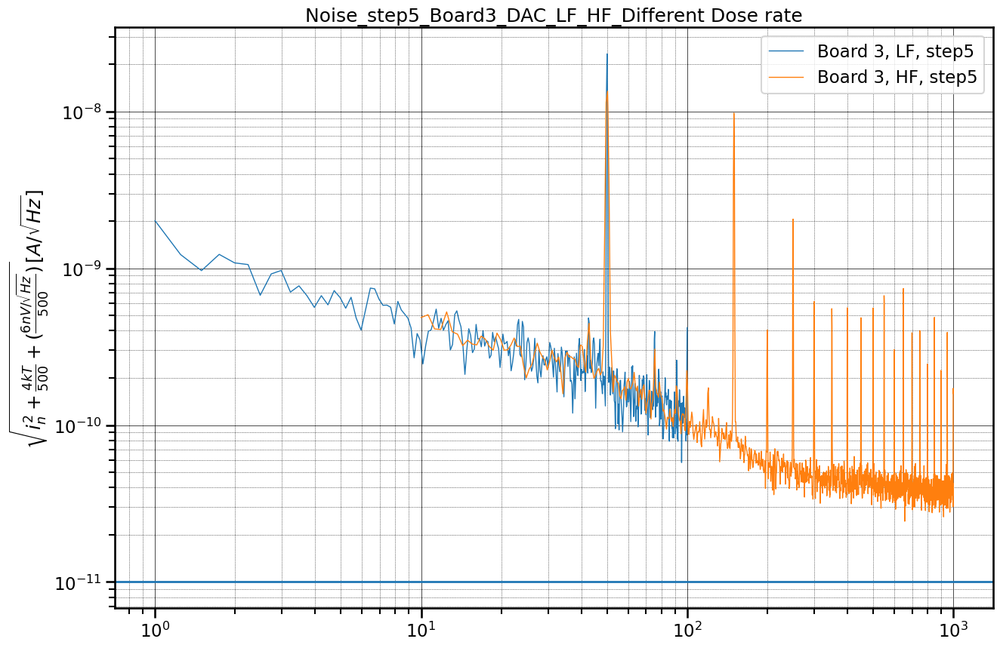

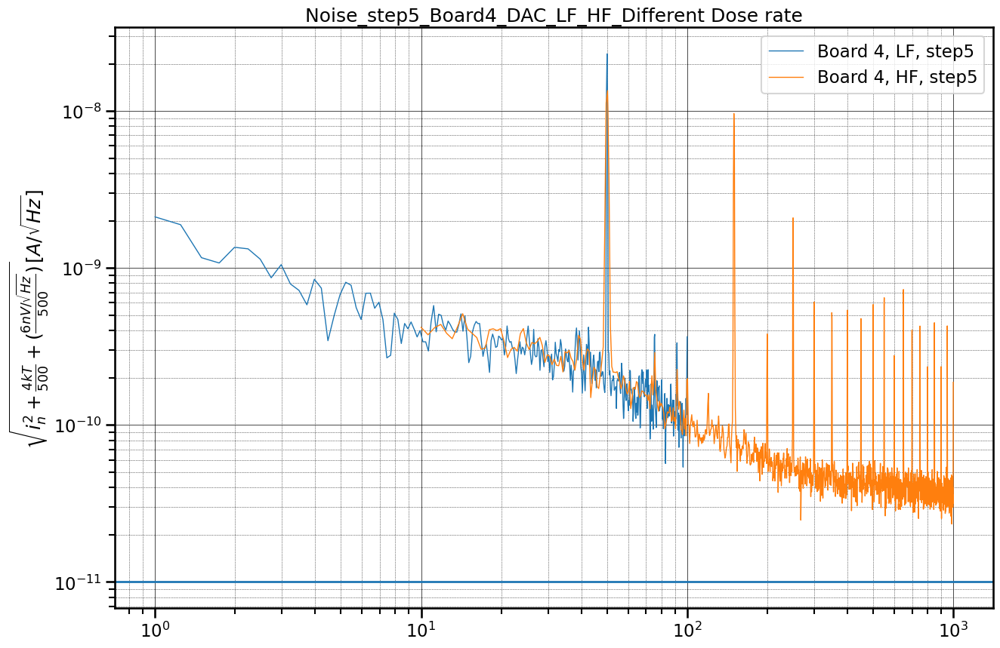

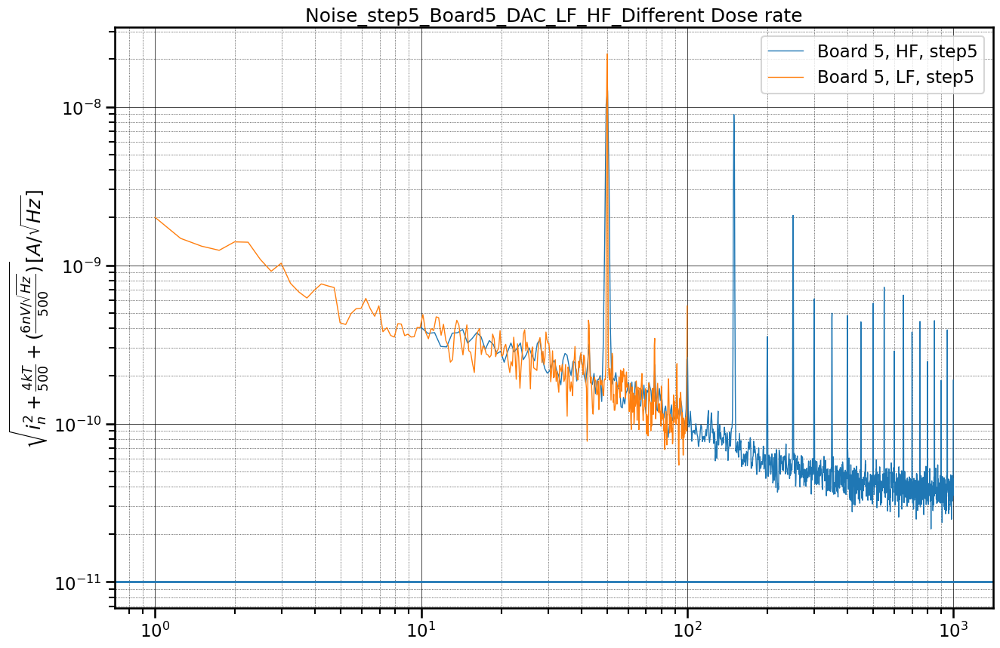

...

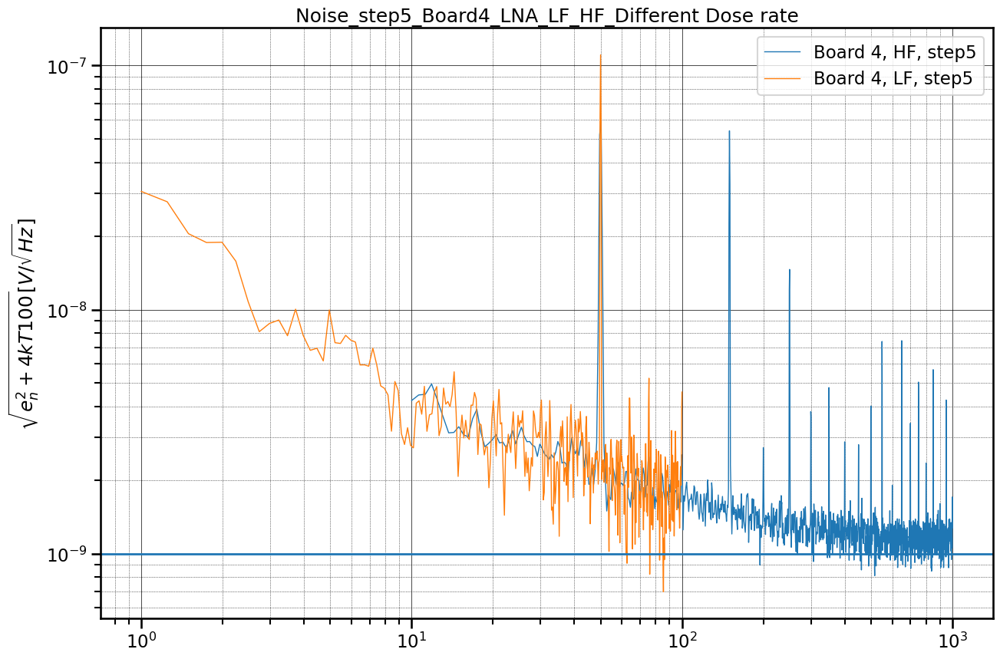

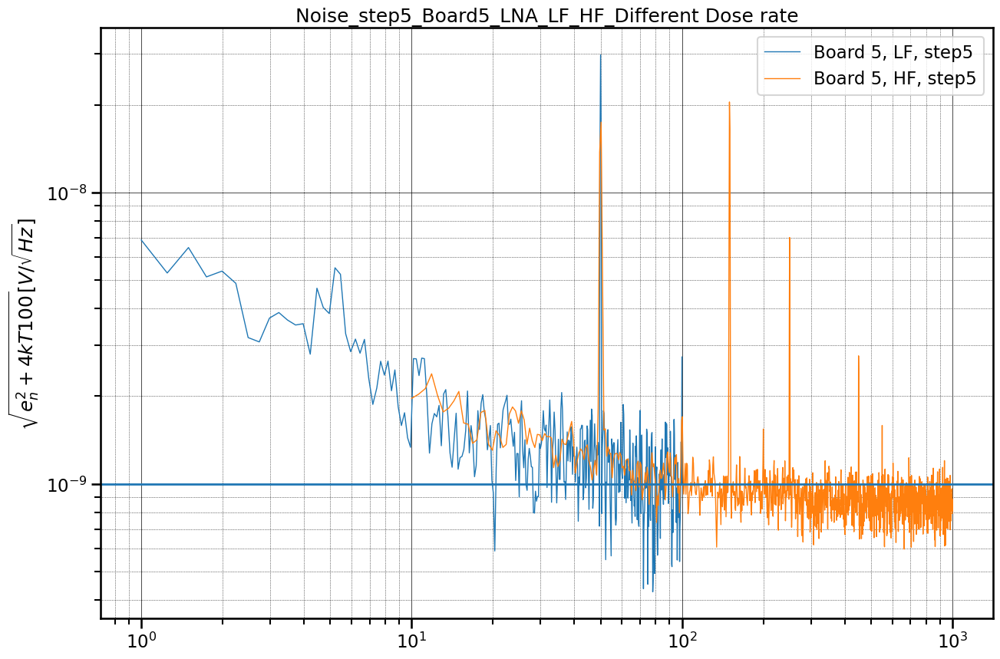

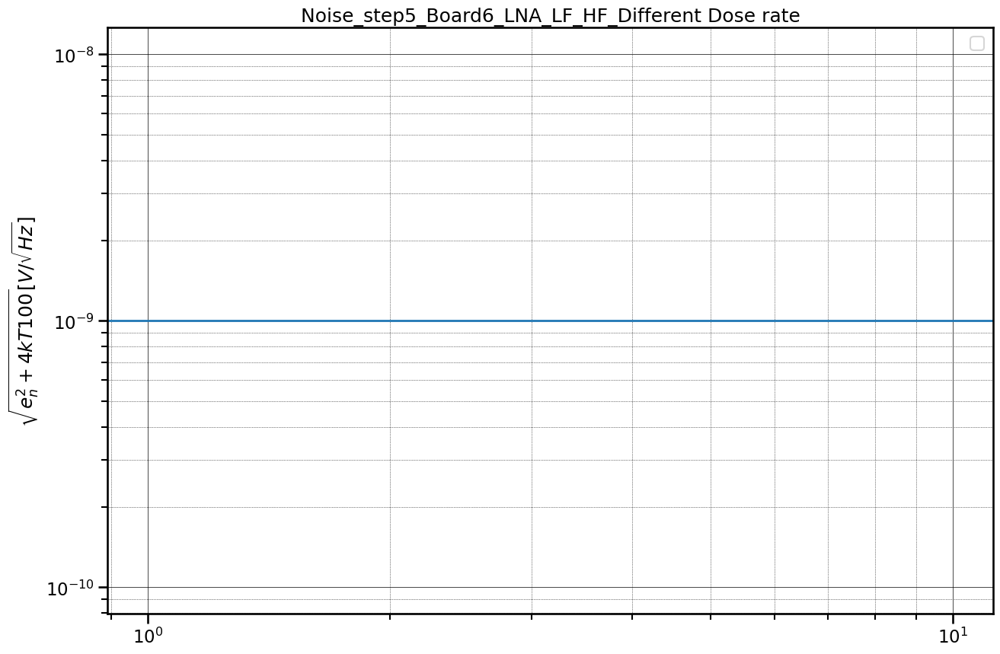

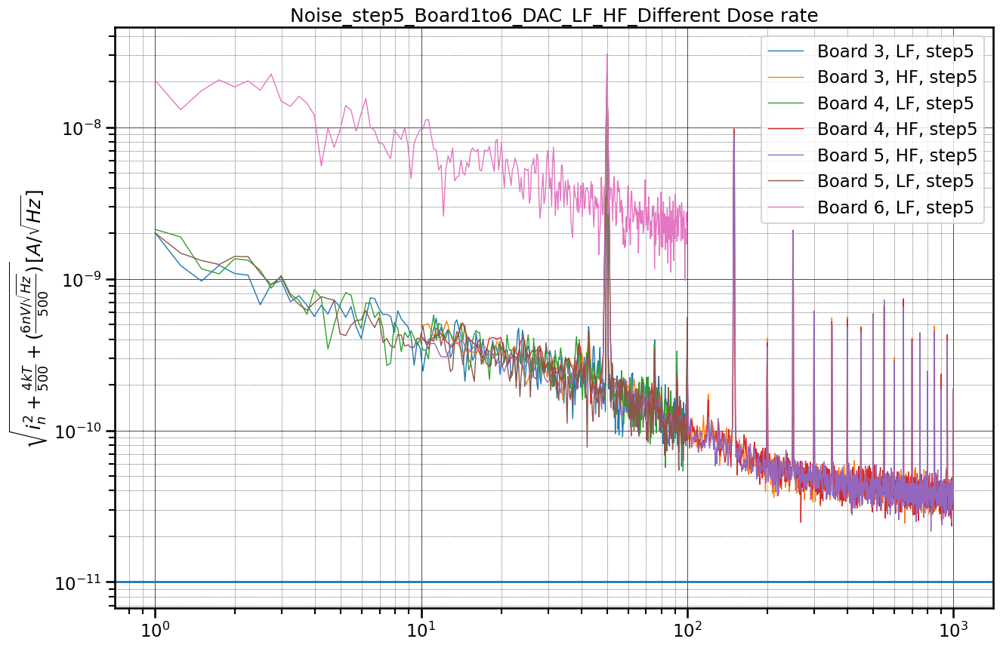

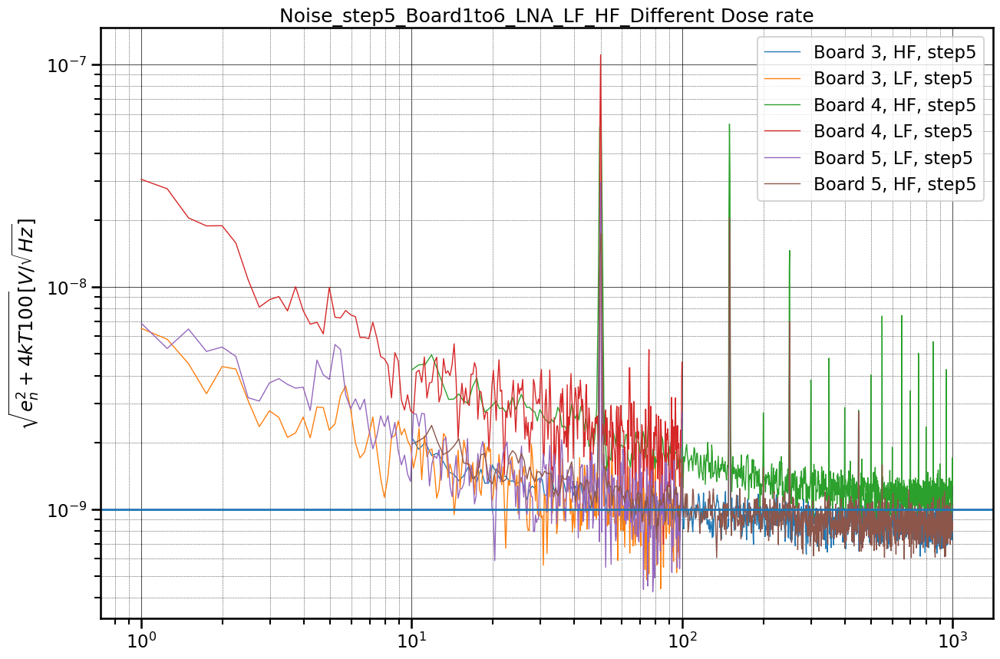

In [11]:
#Step 
step = 'step5'

num = [[1],[2],[3],[4],[5],[6]]
#----------------

type = ['D']
F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#----------------
type = ['L']

F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#-----------------
num = [1,2,3,4,5,6]
#----------------
type = ['D']
F = ['L','H']
plot_noise_per_step(num,type, F, step)
#----------------
type = ['L']
F = ['L','H']
plot_noise_per_step(num,type, F, step)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []
There are 2 files in the sorted list, they are ['B3DLF6.TXT', 'B3DHF6.TXT']
There are 2 files in the sorted list, they are ['B4DLF6.TXT', 'B4DHF6.TXT']


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []
There are 2 files in the sorted list, they are ['B6DHF6.TXT', 'B6DLF6.TXT']


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []
There are 2 files in the sorted list, they are ['B3LHF6.TXT', 'B3LLF6.TXT']
There are 2 files in the sorted list, they are ['B4LHF6.TXT', 'B4LLF6.TXT']
There are 2 files in the sorted list, they are ['B5LLF6.TXT', 'B5LHF6.TXT']
There are 2 files in the sorted list, they are ['B6LLF6.TXT', 'B6LHF6.TXT']
There are 6 files in the sorted list, they are ['B3DLF6.TXT', 'B3DHF6.TXT', 'B4DLF6.TXT', 'B4DHF6.TXT', 'B6DHF6.TXT', 'B6DLF6.TXT']
There are 8 files in the sorted list, they are ['B3LHF6.TXT', 'B3LLF6.TXT', 'B4LHF6.TXT', 'B4LLF6.TXT', 'B5LLF6.TXT', 'B5LHF6.TXT', 'B6LLF6.TXT', 'B6LHF6.TXT']


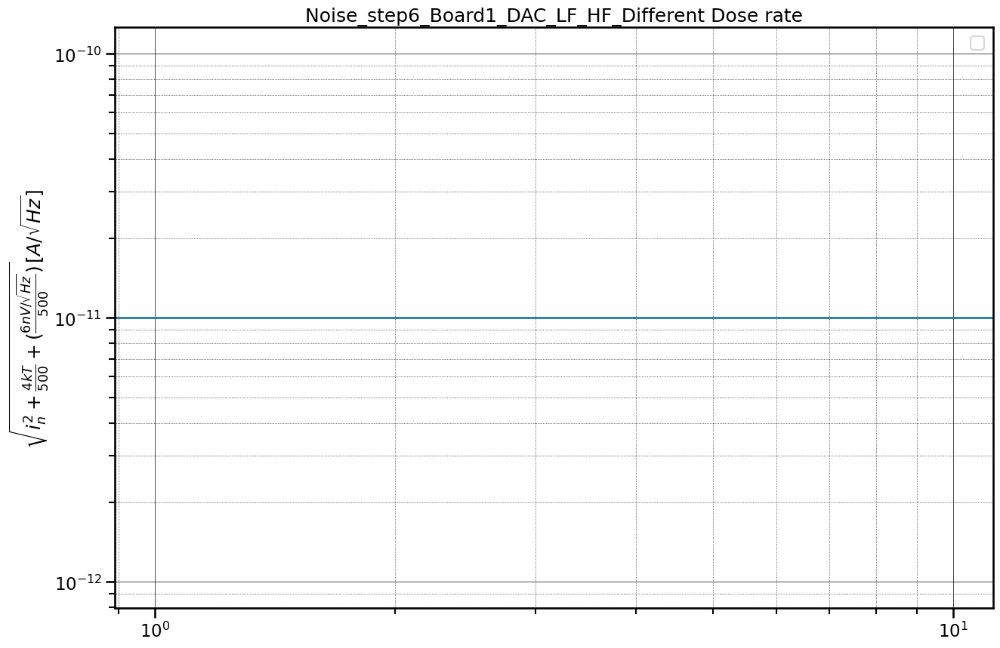

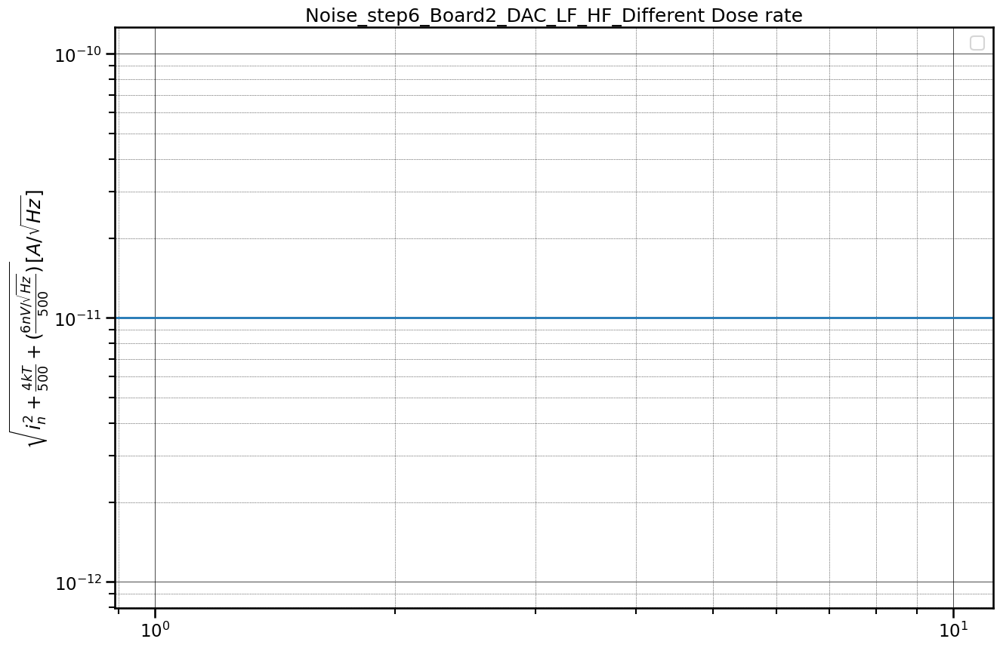

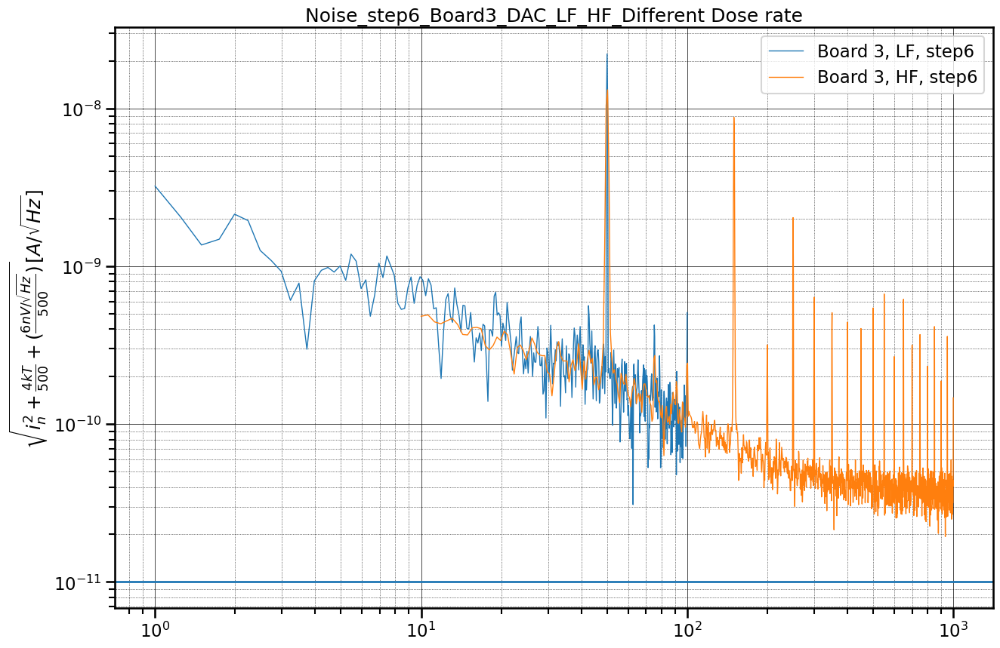

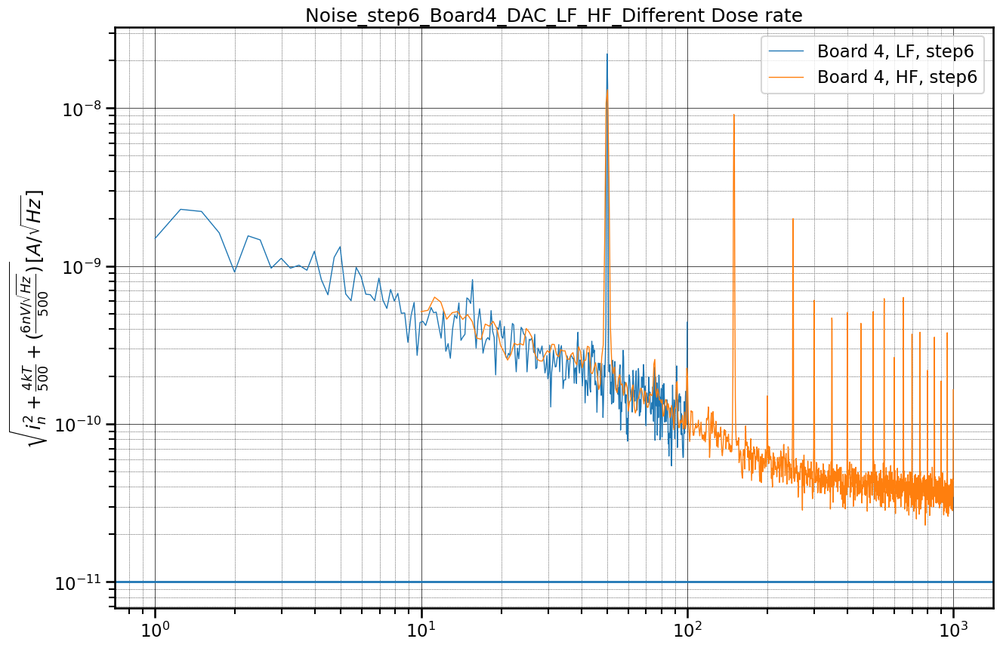

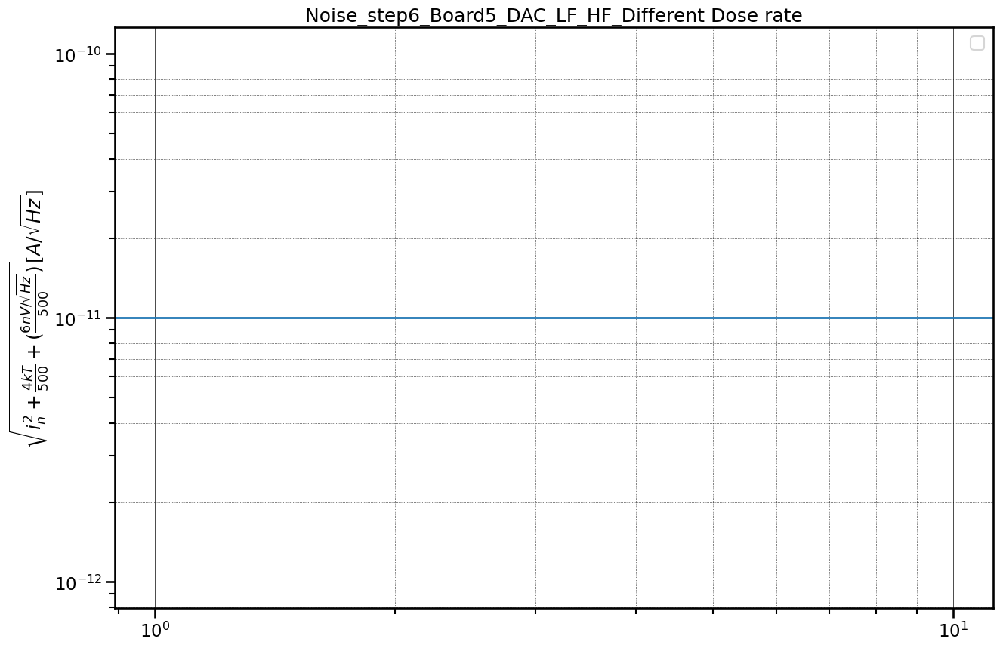

...

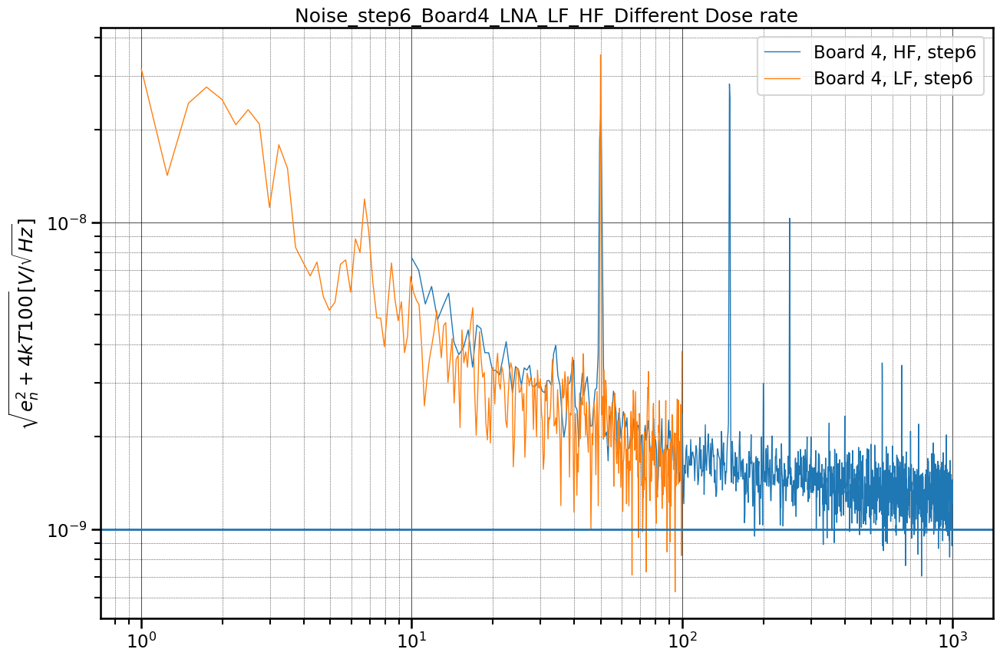

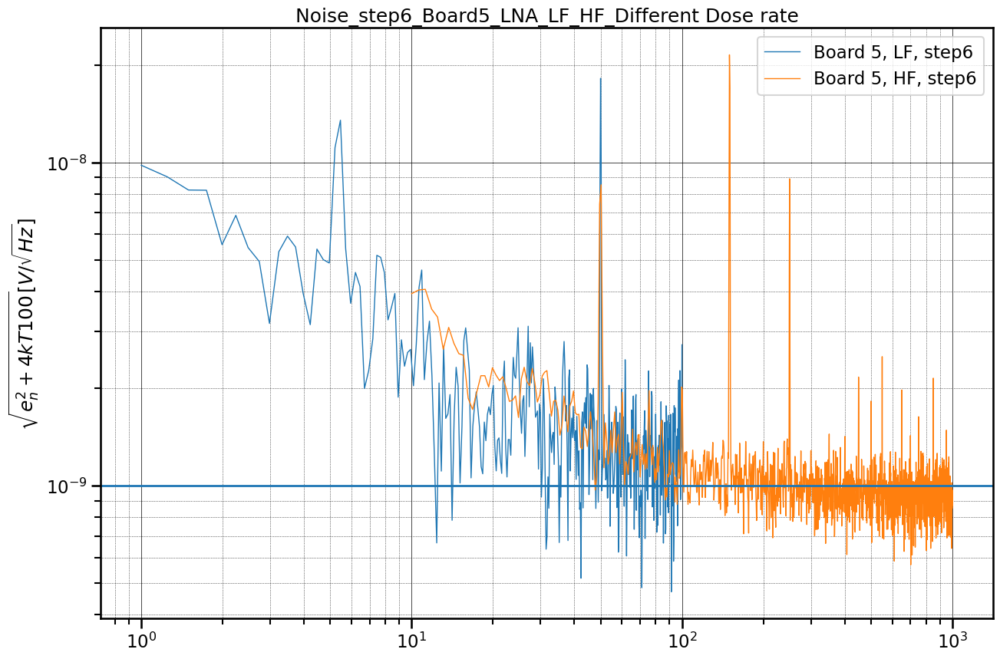

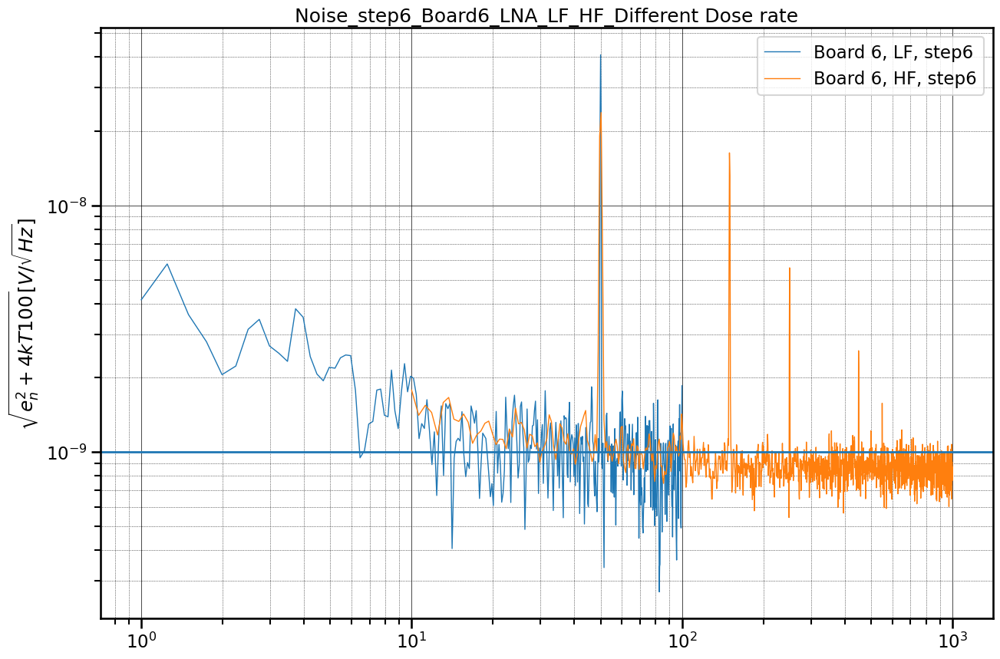

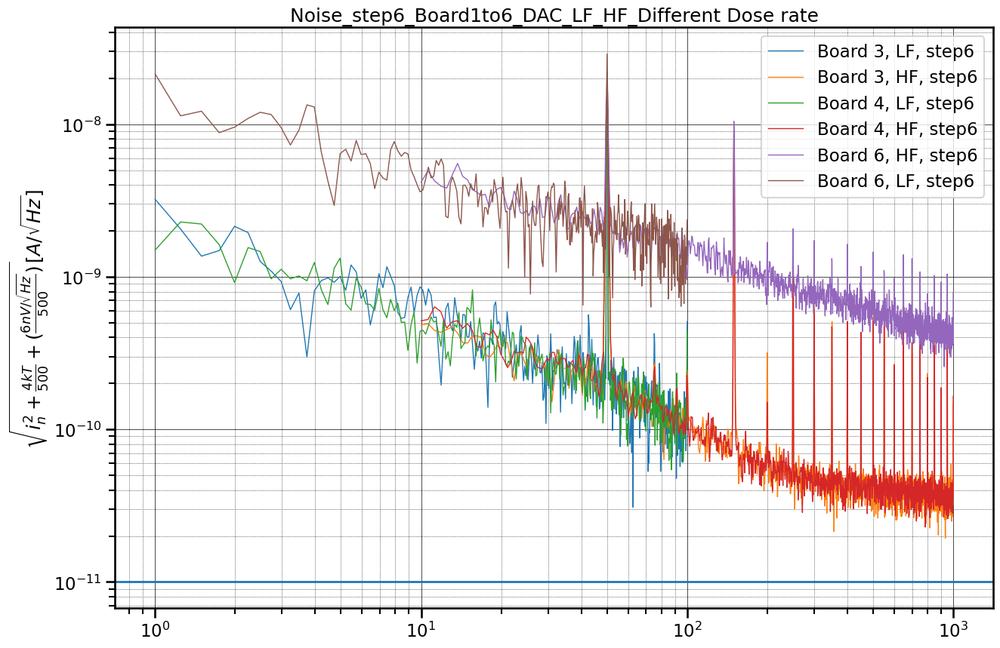

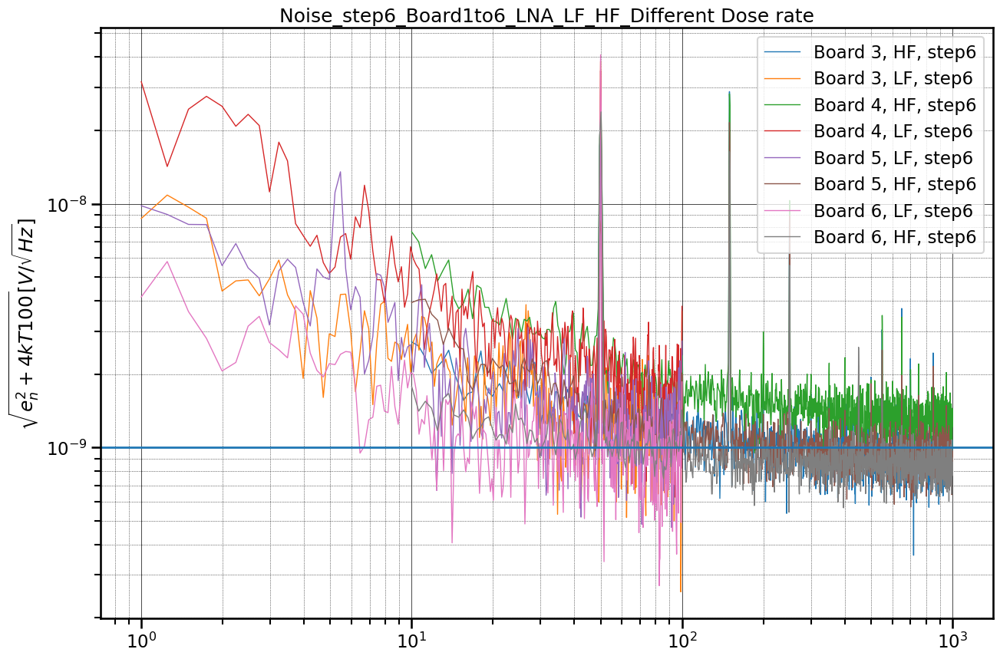

In [12]:
#Step 
step = 'step6'

num = [[1],[2],[3],[4],[5],[6]]
#----------------

type = ['D']
F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#----------------
type = ['L']

F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#-----------------
num = [1,2,3,4,5,6]
#----------------
type = ['D']
F = ['L','H']
plot_noise_per_step(num,type, F, step)
#----------------
type = ['L']
F = ['L','H']
plot_noise_per_step(num,type, F, step)

There are 4 files in the sorted list, they are ['B1DLF8.TXT', 'B1DHF8.TXT', 'B1DHF7.TXT', 'B1DLF7.TXT']
There are 2 files in the sorted list, they are ['B2DHF7.TXT', 'B2DLF7.TXT']
There are 2 files in the sorted list, they are ['B3DLF7.TXT', 'B3DHF7.TXT']
There are 2 files in the sorted list, they are ['B4DLF7.TXT', 'B4DHF7.TXT']
There are 2 files in the sorted list, they are ['B5DHF7.TXT', 'B5DLF7.TXT']
There are 1 files in the sorted list, they are ['B6DHF7.TXT']
There are 2 files in the sorted list, they are ['B1LLF8.TXT', 'B1LLF7.TXT']
There are 2 files in the sorted list, they are ['B2LLF7.TXT', 'B2LHF7.TXT']
There are 2 files in the sorted list, they are ['B3LHF7.TXT', 'B3LLF7.TXT']


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []
There are 2 files in the sorted list, they are ['B5LLF7.TXT', 'B5LHF7.TXT']


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


There are 0 files in the sorted list, they are []
There are 13 files in the sorted list, they are ['B1DLF8.TXT', 'B1DHF8.TXT', 'B1DHF7.TXT', 'B1DLF7.TXT', 'B2DHF7.TXT', 'B2DLF7.TXT', 'B3DLF7.TXT', 'B3DHF7.TXT', 'B4DLF7.TXT', 'B4DHF7.TXT', 'B5DHF7.TXT', 'B5DLF7.TXT', 'B6DHF7.TXT']
There are 8 files in the sorted list, they are ['B1LLF8.TXT', 'B1LLF7.TXT', 'B2LLF7.TXT', 'B2LHF7.TXT', 'B3LHF7.TXT', 'B3LLF7.TXT', 'B5LLF7.TXT', 'B5LHF7.TXT']


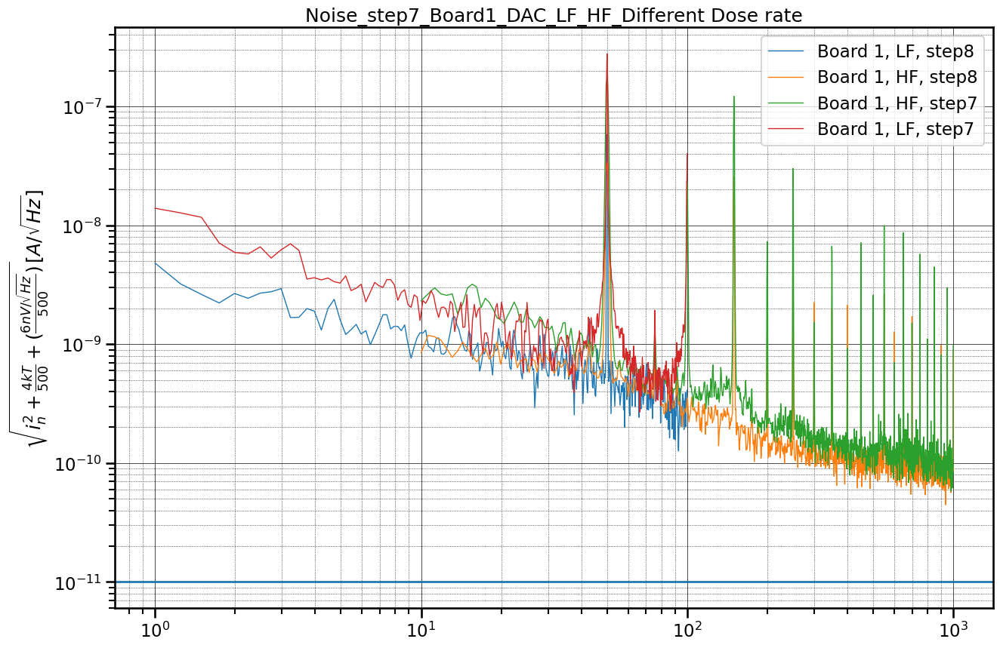

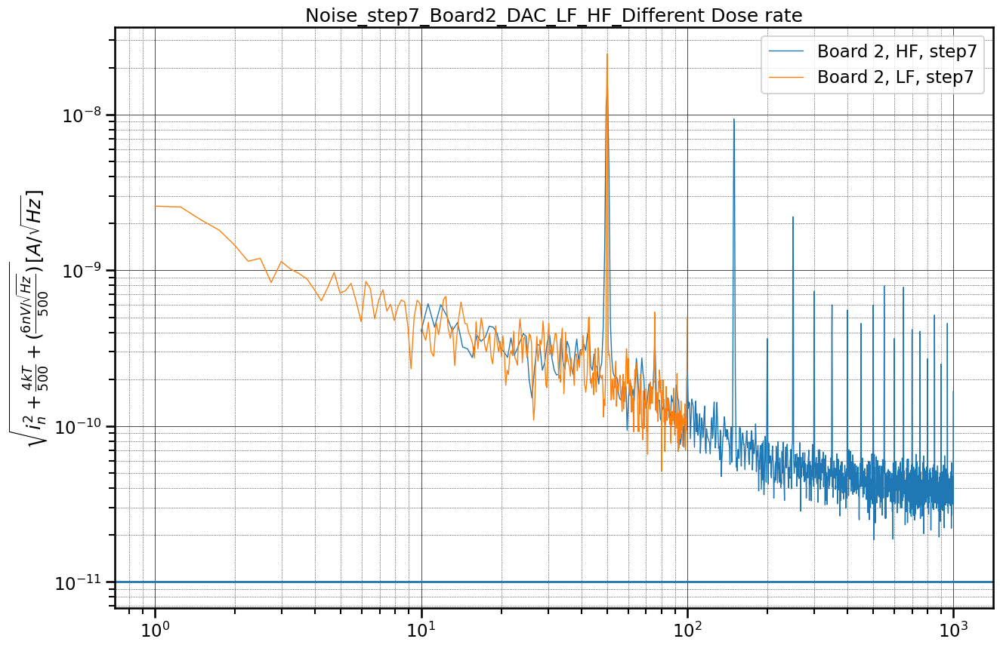

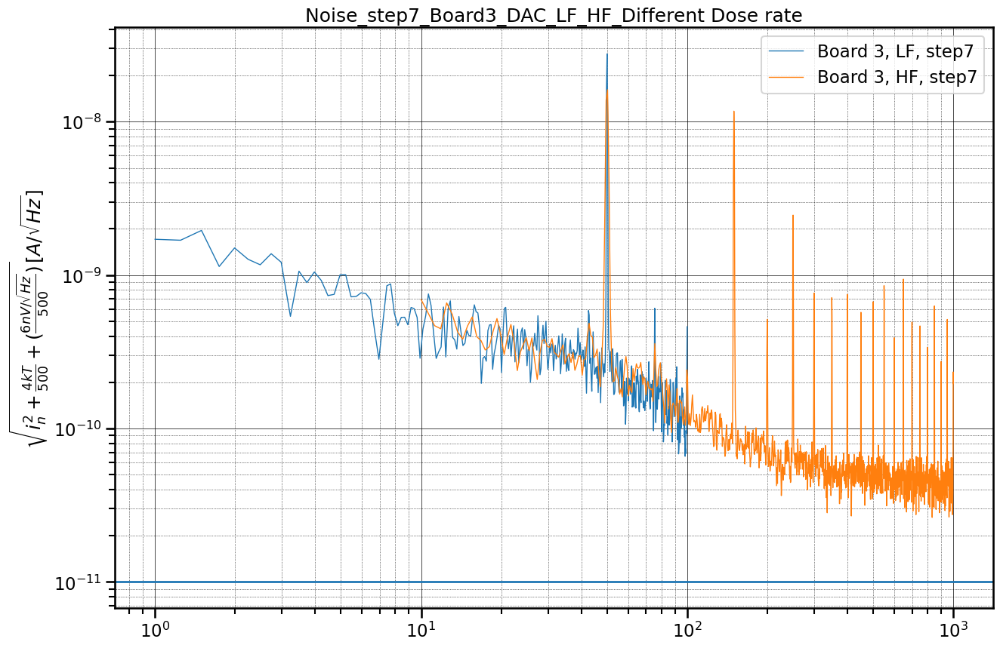

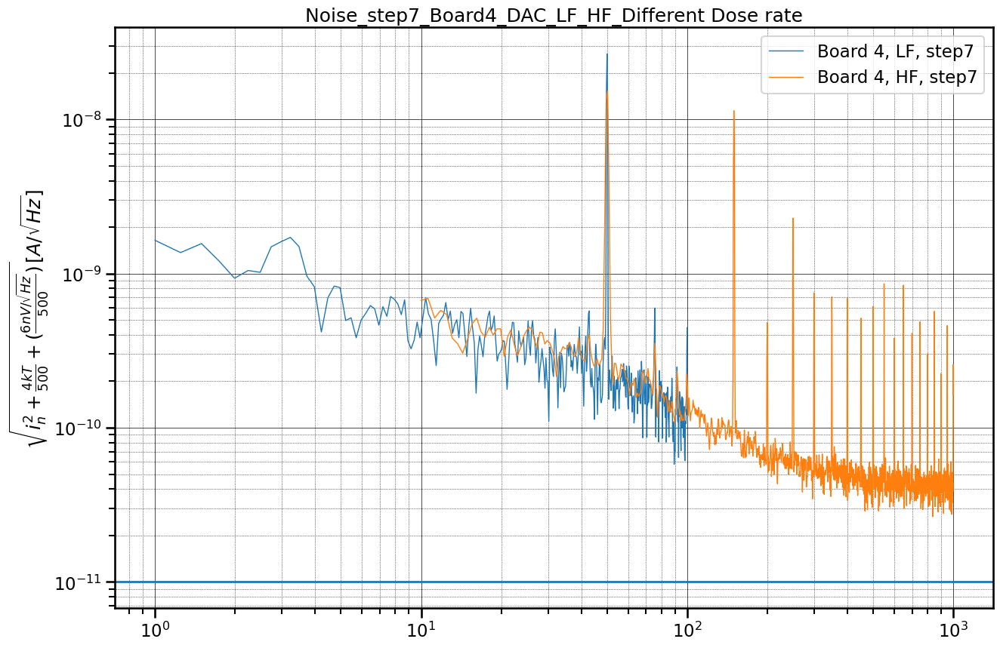

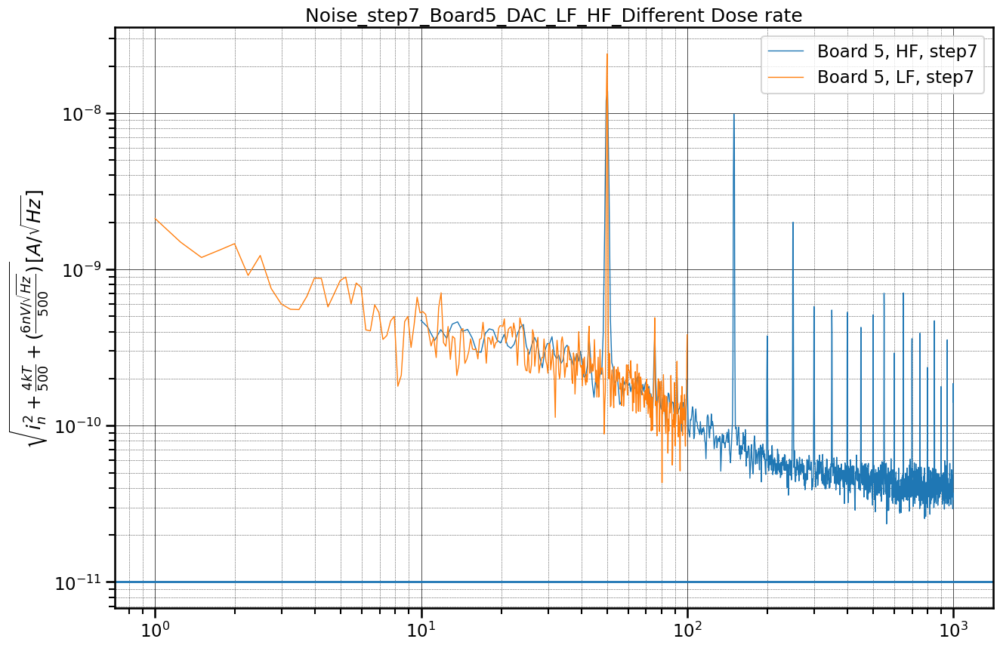

...

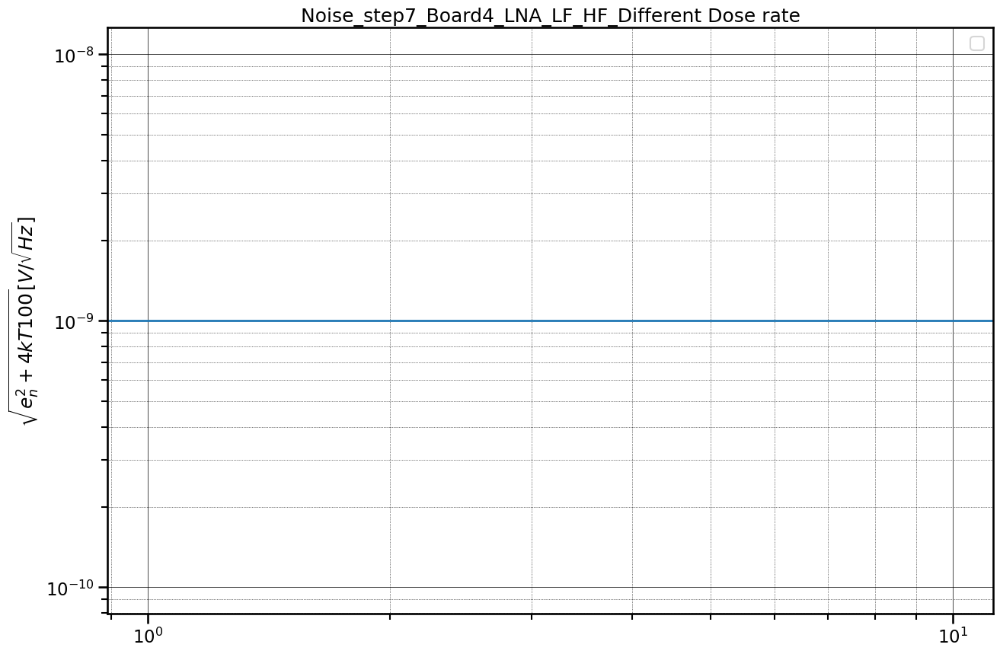

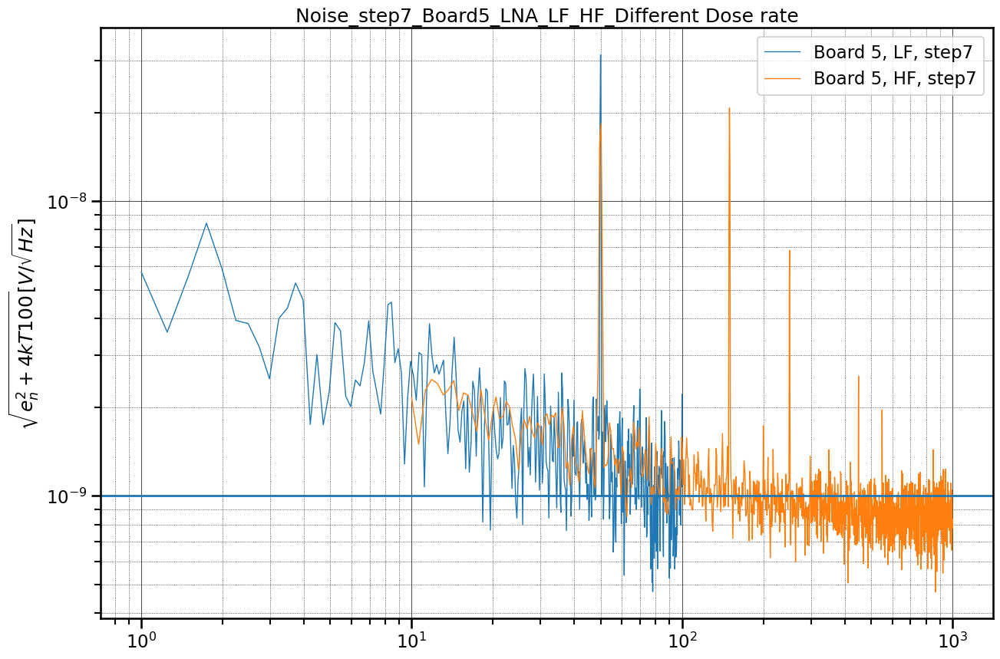

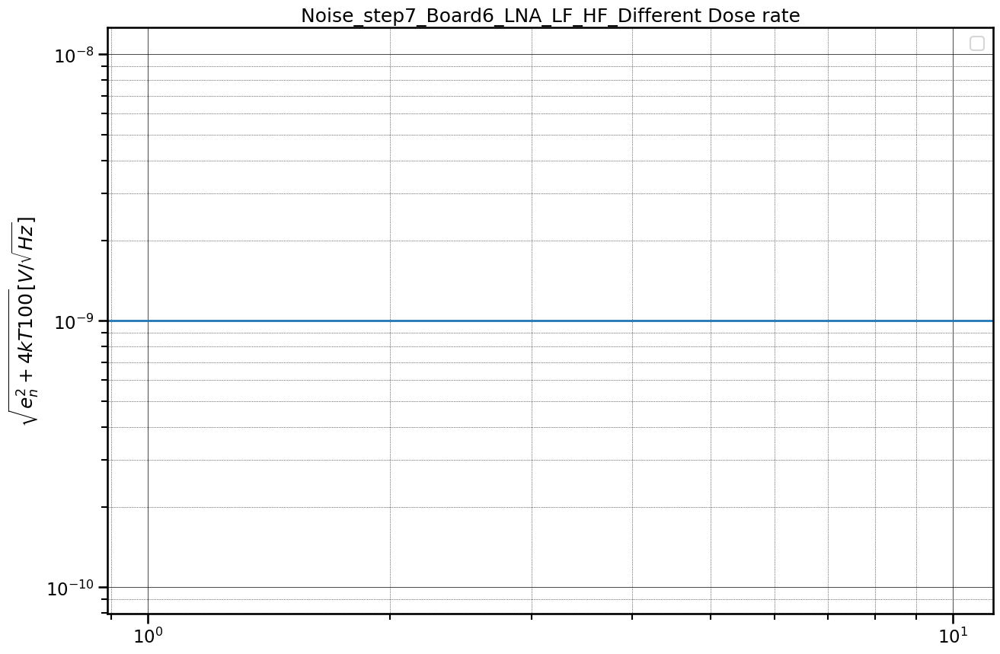

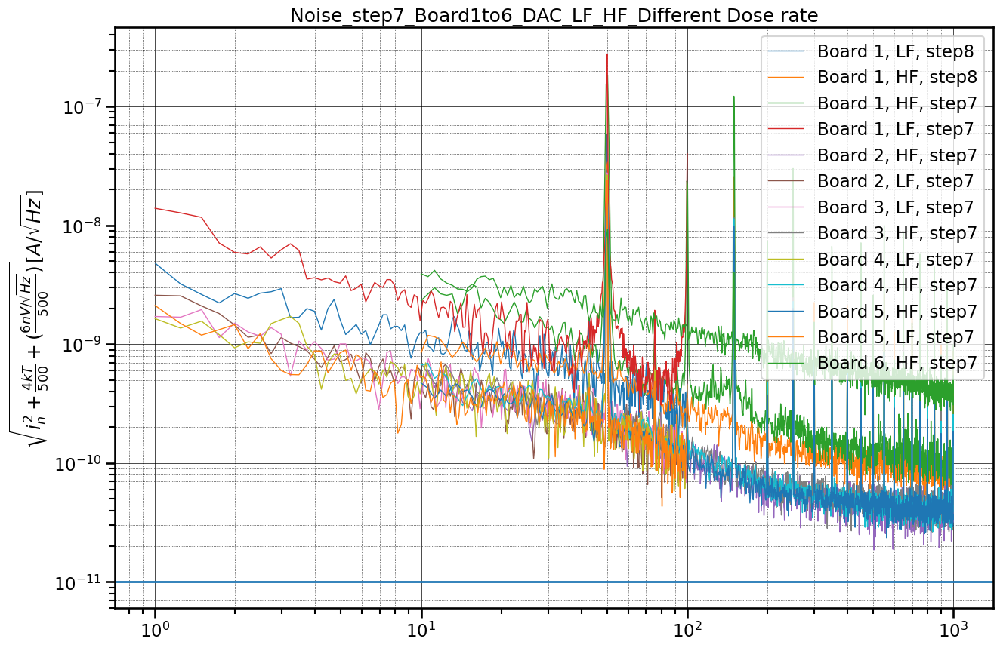

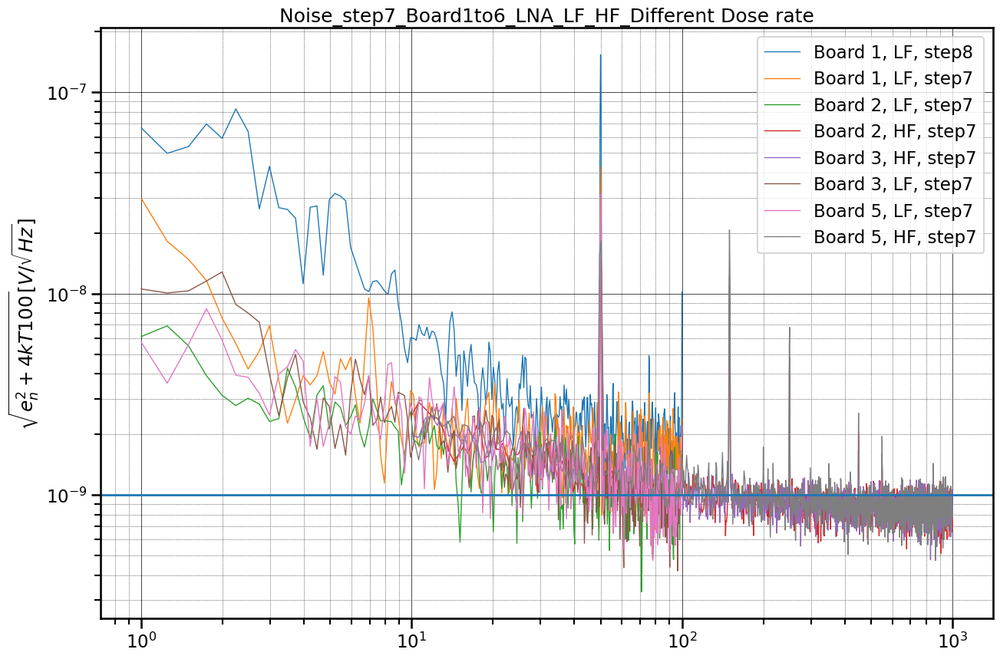

In [13]:
#Step 
step = 'step7'

num = [[1],[2],[3],[4],[5],[6]]
#----------------

type = ['D']
F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#----------------
type = ['L']

F = ['L','H']
for i in num:
    plot_noise_per_step(i,type, F, step)
#-----------------
num = [1,2,3,4,5,6]
#----------------
type = ['D']
F = ['L','H']
plot_noise_per_step(num,type, F, step)
#----------------
type = ['L']
F = ['L','H']
plot_noise_per_step(num,type, F, step)

In [40]:
def plot_noise_per_step(board_number,type, F, step):
    dir_sv1 = step
    f0,val0, name0 = sort_data(DATA_DIR, step, board_number, type, F)
    
    #line_label
    f_label = []
    for i in range(len(name0)):
        if name0[i][3] == 'L':
            f_label.append('LF')
        elif name0[i][3] == 'H':
            f_label.append('HF')
    # plt.figure(figsize = (15,10))
    if type[0] == 'D':
        if len(F) > 1:
            f = 'DAC_LF_HF'
        else:
            if F[0] == 'L':
                f = 'DAC_LF'
            elif F[0] == 'H':
                f = 'DAC_HF'
        # label = '$\sqrt{i_n^2 + \frac{4kT}{500} + (\frac{6nV/\sqrt{Hz}}{500})} [A/\sqrt{Hz}]$'
        plt.ylabel(r'$\sqrt{i_n^2 + \frac{4kT}{500} + (\frac{6nV/\sqrt{Hz}}{500})} [A/\sqrt{Hz}]$')
    if type[0] == 'L':
        if len(F) > 1:
            f = 'LNA_LF_HF'
        else:
            if F[0] == 'L':
                f = 'LNA_LF'
            elif F[0] == 'H':
                f = 'LNA_HF'
        # label = '$\sqrt{i_n^2 + \frac{4kT}{500} + (\frac{6nV/\sqrt{Hz}}{500})} [A/\sqrt{Hz}]$'
        plt.ylabel(r'$\sqrt{e_n^2 + 4kT100} [V/ \sqrt{Hz}] $')   

        
    name =   f'Board{board_number[0]}_' + f 
    if len(board_number) > 1:
        name =   f'Noise_{step}_' + 'Board1to6_' + f  
    plt.title(f'{name}')
    for i in range(len(val0)):
        step = 'step' + f'{name0[i][5]}'
        plt.plot(f0[i],val0[i],lw = 1, label = f'Board {name0[i][1]}, {f_label[i]}, {step}')
    if type[0] == 'D':
        plt.axhline(y = 10e-12, lw = 2)
    elif type[0] == 'L':
        plt.axhline(y = 1e-9, lw = 2)
    
    plt.xscale('log')
    plt.yscale('log')
    #plt.ylabel(f'{label}')
    plt.grid(which='major', linestyle='-', linewidth='0.5', color='black')
    # Customize the minor grid
    plt.grid(which='minor', linestyle=':', linewidth='0.5', color='black')
    plt.legend(loc = 'upper right')
    # plt.savefig(f'plots/{dir_sv1}/{name}.png')

There are 2 files in the sorted list, they are ['B6DLF0.TXT', 'B6DHF0.TXT']
There are 2 files in the sorted list, they are ['B6DLF1.TXT', 'B6DHF1.TXT']
There are 0 files in the sorted list, they are []
There are 2 files in the sorted list, they are ['B6DLF3.TXT', 'B6DHF3.TXT']
There are 2 files in the sorted list, they are ['B6DHF4.TXT', 'B6DLF4.TXT']
There are 1 files in the sorted list, they are ['B6DLF5.TXT']
There are 2 files in the sorted list, they are ['B6DHF6.TXT', 'B6DLF6.TXT']
There are 1 files in the sorted list, they are ['B6DHF7.TXT']
There are 4 files in the sorted list, they are ['B6DLF9.TXT', 'B6DLF10.TXT', 'B6DHF9.TXT', 'B6DHF10.TXT']
There are 2 files in the sorted list, they are ['B6LHF0.TXT', 'B6LLF0.TXT']
There are 2 files in the sorted list, they are ['B6LHF1.TXT', 'B6LLF1.TXT']
There are 2 files in the sorted list, they are ['B6LHF2.TXT', 'B6LLF2.TXT']
There are 1 files in the sorted list, they are ['B6LLF3.TXT']
There are 2 files in the sorted list, they are ['B

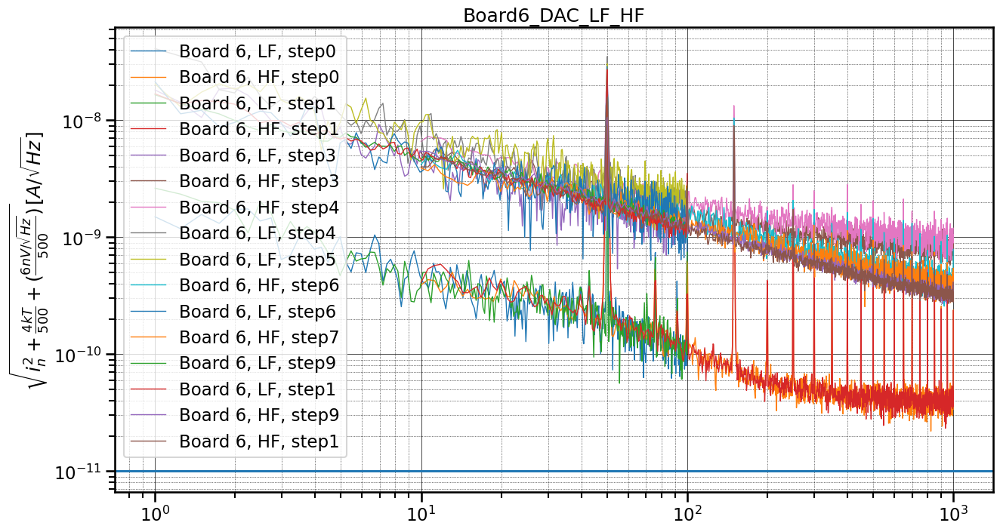

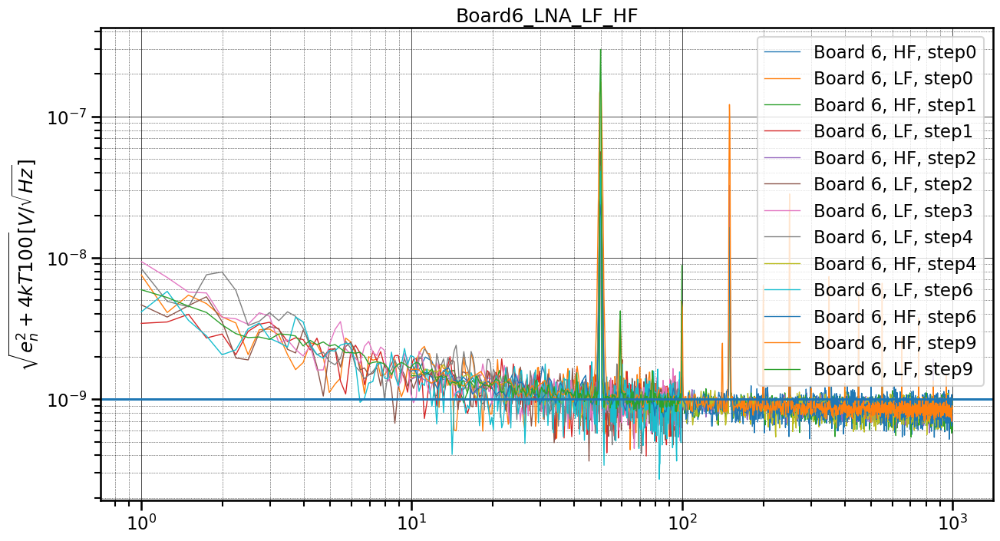

In [46]:
step = 'step9'

num = [6]
#----------------
step = ['step0','step1','step2','step3','step4','step5','step6','step7','step9']
type = ['D']
F = ['L','H']

plt.figure(figsize = (15,8))
for i in step:
    plot_noise_per_step(num,type, F, i)
plt.legend(loc = 'upper left')
plt.savefig(f'plots/step9/DAC_board6.png')
#----------------
type = ['L']
plt.figure(figsize = (15,8))
F = ['L','H']
for i in step:
    plot_noise_per_step(num,type, F, i)
plt.savefig(f'plots/step9/LNA_board6.png')
# # #-----------------
# num = [1,2,3,4,5,6]
# #----------------
# type = ['D']
# F = ['L','H']
# plot_noise_per_step(num,type, F, step)
# #----------------
# type = ['L']
# F = ['L','H']
# plot_noise_per_step(num,type, F, step)

There are 2 files in the sorted list, they are ['B6DLF0.TXT', 'B6DHF0.TXT']
There are 4 files in the sorted list, they are ['B6DHFa.TXT', 'B6DLFa.TXT', 'B6DLF9.TXT', 'B6DHF9.TXT']
There are 0 files in the sorted list, they are []
There are 2 files in the sorted list, they are ['B2DLF9.TXT', 'B2DHF9.TXT']
There are 2 files in the sorted list, they are ['B6LHF0.TXT', 'B6LLF0.TXT']
There are 2 files in the sorted list, they are ['B6LHF9.TXT', 'B6LLF9.TXT']


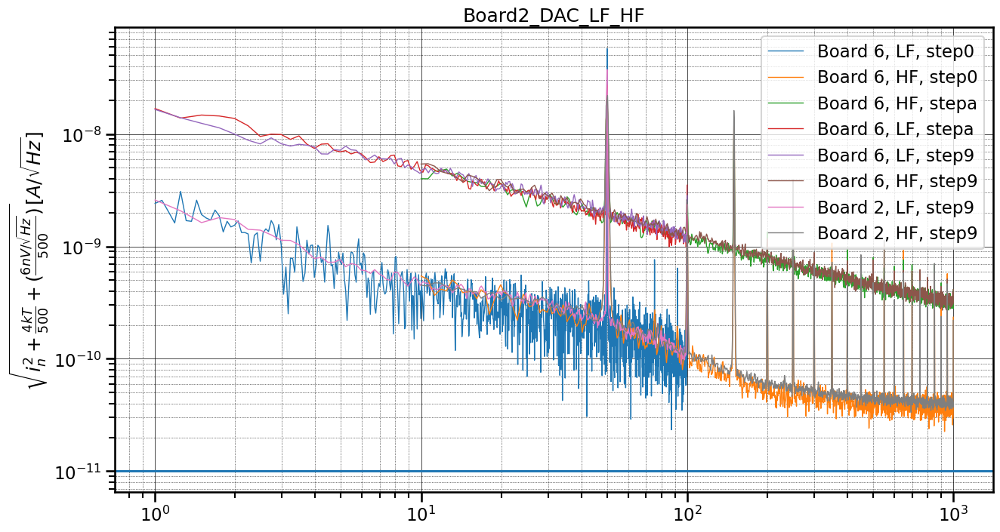

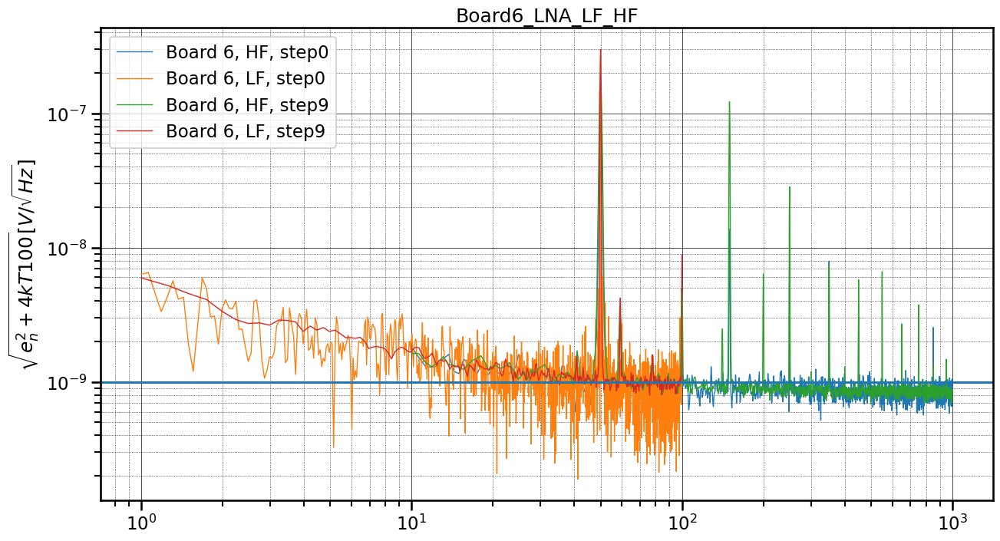

In [49]:
num = [6]
#----------------
step = ['step10','step9']
type = ['D']
F = ['L','H']
plt.figure(figsize = (15,8))
for i in step:
    plot_noise_per_step(num,type, F, i)
# plt.legend(loc = 'upper left')
for i in step:
    plot_noise_per_step([2],type, F, i)
plt.legend(loc = 'upper right')
plt.savefig(f'plots/step9/DAC_board6_board2_int_and_step9.png')

step = ['step10','step9']
type = ['L']
F = ['L','H']
plt.figure(figsize = (15,8))
for i in step:
    plot_noise_per_step(num,type, F, i)
plt.legend(loc = 'upper left')
plt.savefig(f'plots/step9/LNA_board6_int_and_step9.png')

TypeError: can only concatenate str (not "list") to str